## Sim Demo

### Imports

In [1]:
%load_ext autoreload
%autoreload 2

In [2]:
from env.imports import *

/ext3/miniconda3/lib/python3.11/site-packages/pandas/core/arrays/masked.py:60: UserWarning: Pandas requires version '1.3.6' or newer of 'bottleneck' (version '1.3.5' currently installed).
  from pandas.core import (
2025-11-14 20:45:45.145195: I tensorflow/core/util/port.cc:110] oneDNN custom operations are on. You may see slightly different numerical results due to floating-point round-off errors from different computation orders. To turn them off, set the environment variable `TF_ENABLE_ONEDNN_OPTS=0`.
2025-11-14 20:45:45.938340: I tensorflow/tsl/cuda/cudart_stub.cc:28] Could not find cuda drivers on your machine, GPU will not be used.
2025-11-14 20:45:46.328448: I tensorflow/tsl/cuda/cudart_stub.cc:28] Could not find cuda drivers on your machine, GPU will not be used.
2025-11-14 20:45:46.329267: I tensorflow/core/platform/cpu_feature_guard.cc:182] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instruc

In [3]:
import importlib
import data

import models
import sim.sim
import sim.sim_utils
from sim.sim_utils import bytes2human, print_system_usage
from sim.sim import Simulation
from sim.sim_run import single_sim_run

importlib.reload(sim.sim)
importlib.reload(sim.sim_run)
importlib.reload(models.train_val)
importlib.reload(data.data_utils)
importlib.reload(data.data_load)


Resorting genes by reference genome order
Resorting genes by reference genome order


<module 'data.data_load' from '/scratch/asr655/neuroinformatics/GeneEx2Conn/data/data_load.py'>

#### Check job specs

In [4]:
print_system_usage()

total = psutil.disk_usage('/').total
print(bytes2human(total))

CPU Usage: 5.0%
RAM Usage: 9.2%
Available RAM: 1.3T
Total RAM: 1.5T
52.4G


In [5]:
print(os.environ.get("CUDA_VISIBLE_DEVICES"))

# Check available GPUs
print(f"Available GPUs: {torch.cuda.device_count()}")

for i in range(torch.cuda.device_count()):
    print(f"GPU {i}: {torch.cuda.get_device_name(i)} - Memory Allocated: {torch.cuda.memory_allocated(i)/1024**3:.2f} GB")


0
Available GPUs: 1
GPU 0: NVIDIA H100 80GB HBM3 - Memory Allocated: 0.00 GB


In [6]:
print("XGBoost version:", xgboost.__version__)
print("cupy version:", cp.__version__)

GPUtil.getAvailable()

# if a number is seen a GPU is available
GPUtil.getGPUs()

DEVICE_ID_LIST = GPUtil.getFirstAvailable()
DEVICE_ID = DEVICE_ID_LIST[0] # grab first element from list
if DEVICE_ID != None: 
    print('GPU found', DEVICE_ID)
    use_gpu = True

    GPUtil.showUtilization()

XGBoost version: 2.0.3
cupy version: 13.1.0
GPU found 0
| ID | GPU | MEM |
------------------
|  0 |  0% |  0% |


In [7]:
torch.cuda.is_available()

# Clear GPU memory
if torch.cuda.is_available():
    torch.cuda.empty_cache()

## Simulation tests <a id="sims"></a>

In [26]:
torch._dynamo.reset()

Number of components for 95% variance PCA: 3
Number of 1s: 36662, Number of 0s: 171274, Class balance (1s): 0.176
Number of 1s: 17738, Number of 0s: 190198, Class balance (1s): 0.085
X shape: (455, 100)
X_pca shape: (455, 3)
X_pca_full shape: (455, 100)
X_cell_types_Jorstad shape: (455, 24)
X_cell_types_LakeDFC shape: (455, 18)
X_cell_types_LakeVIS shape: (455, 18)
Y_sc shape: (455, 455)
Y_sc_spectralL shape: (455, 455)
Y_sc_spectralA shape: (455, 456)
Y_fc shape: (455, 455)
Coordinates shape: (455, 3)
connectome target FC
Y shape (455, 455)
feature_name: transcriptome, processing_type: None
features ['transcriptome']
Feature matrix, X, generated... expanding to pairwise dataset


wandb: WARNING Malformed sweep config detected! This may cause your sweep to behave in unexpected ways.
wandb: WARNING To avoid this, please fix the sweep config schema violations below:
wandb: WARNING   Violation 1. Additional properties are not allowed ('best_parameters' was unexpected)


Create sweep with ID: tywmee2y
Sweep URL: https://wandb.ai/alexander-ratzan-new-york-university/gx2conn/sweeps/tywmee2y
Initialized sweep with ID: tywmee2y


  warnings.warn(



2
3
4
BEST CONFIG {'input_dim': 200, 'learning_rate': 0.0005, 'batch_size': 512, 'regularization': 'l2', 'lambda_reg': 0.1, 'epochs': 100}
Total number of learnable parameters in BilinearCMmodel: 10001
Running train evaluation...

=== TRAIN EVALUATION ===
Evaluating 341 regions, 115940 connections


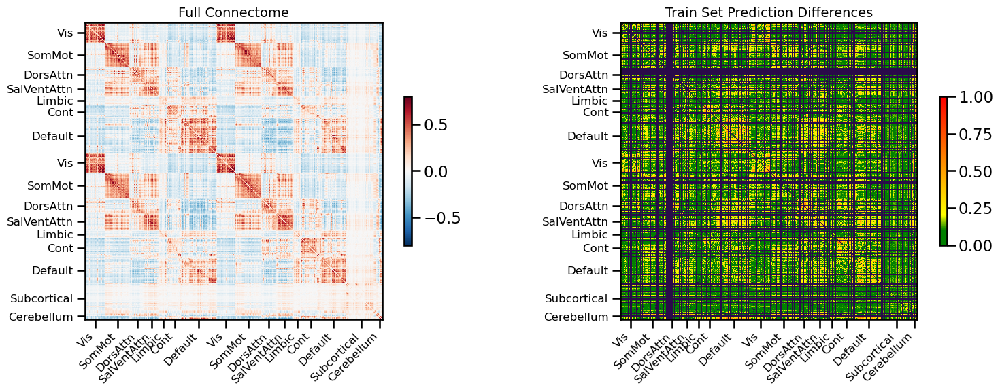

<Figure size 640x480 with 0 Axes>

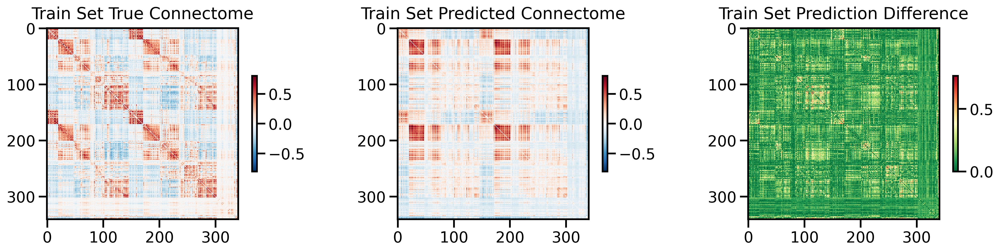

<Figure size 640x480 with 0 Axes>

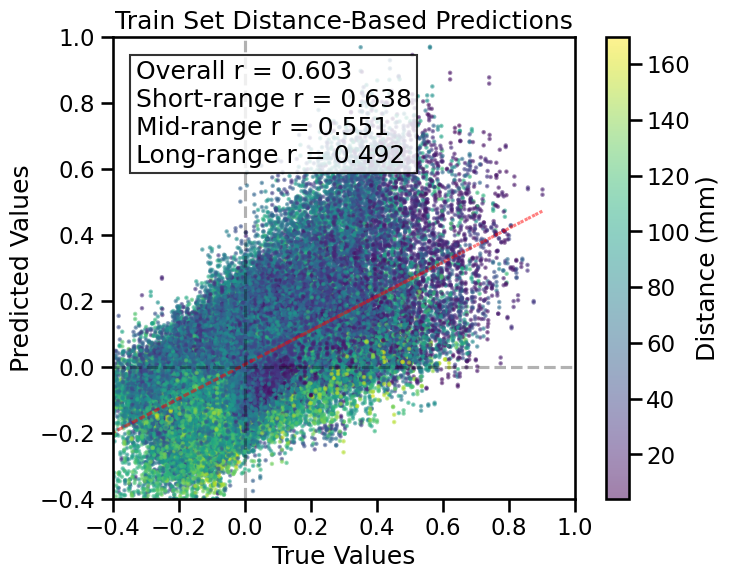

Running test evaluation...

=== TEST EVALUATION ===
Evaluating 114 regions, 12882 connections


<Figure size 640x480 with 0 Axes>

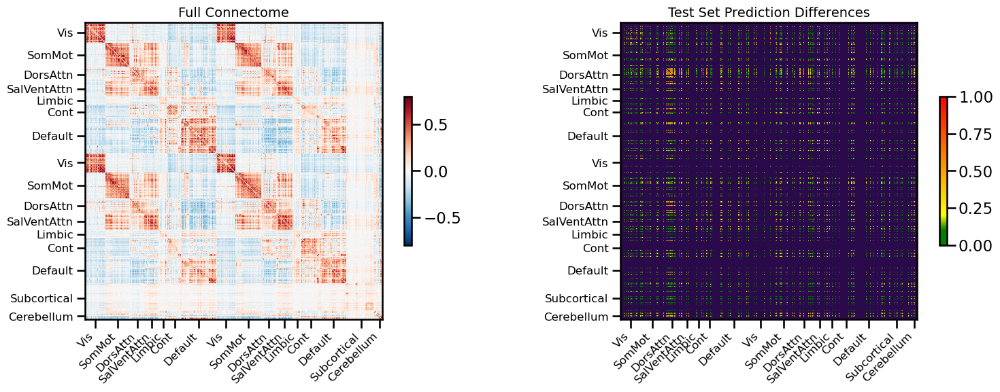

<Figure size 640x480 with 0 Axes>

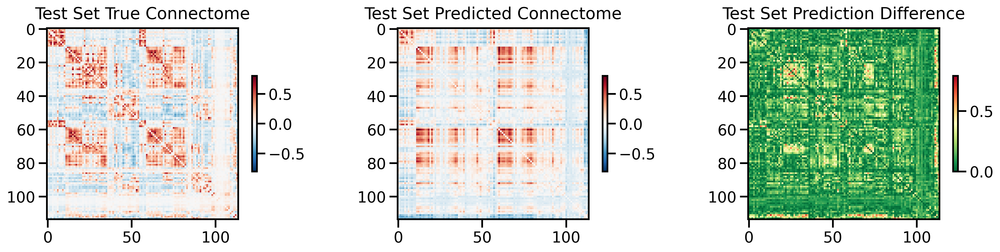

<Figure size 640x480 with 0 Axes>

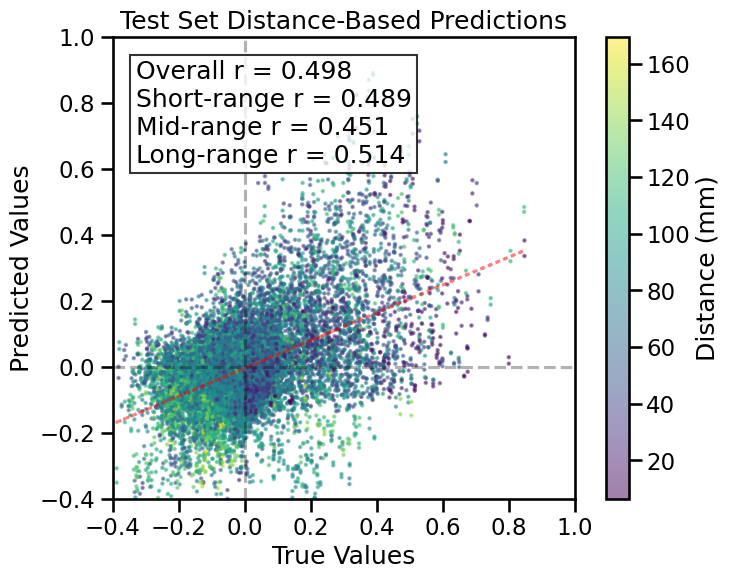

TRAIN METRICS
GLOBAL: mse=0.023716, mae=0.120748, r2=0.2999, pearson_r=0.6029, spearman_r=0.5363, geodesic_distance=32.1032
DISTANCE-BASED: short=0.6380, mid=0.5508, long=0.4925
HEMISPHERIC: left=0.5787, right=0.5874, inter=0.6188
CONNECTION STRENGTH: neg=0.0591, weak=0.4896, pos=0.1610
NETWORK CORRELATIONS:
  NETWORK      INTRA      INTER
  ------------------------------
  Cont          0.6903    0.6767
  Default       0.4219    0.6188
  SalVentAttn    0.7547    0.7025
  Limbic        0.7138    0.6989
  DorsAttn      0.7797    0.7211
  SomMot        0.7543    0.7073
  Vis           0.6893    0.6831
  Subcortical    0.3316    0.6111
  Cerebellum    0.4620    0.5843

TEST METRICS
GLOBAL: mse=0.028897, mae=0.129667, r2=0.1174, pearson_r=0.4979, spearman_r=0.4330, geodesic_distance=18.4930
DISTANCE-BASED: short=0.4890, mid=0.4511, long=0.5145
HEMISPHERIC: left=0.4612, right=0.5618, inter=0.4966
CONNECTION STRENGTH: neg=-0.1329, weak=0.3906, pos=0.1317
NETWORK CORRELATIONS:
  NETWORK      

0

<Figure size 640x480 with 0 Axes>

In [9]:
single_sim_run(
              feature_type=[{'transcriptome': None}],
              train_shared_regions=False,
              test_shared_regions=False,
              omit_subcortical=False,
              dataset='UKBB',
              parcellation='S456',
              hemisphere='both',
              connectome_target='FC',
              impute_strategy='mirror_interpolate',
              sort_genes='refgenome',
              gene_list='100_var',
              cv_type='random',
              random_seed=42,
              search_method=('wandb', 'mse', 2),
              track_wandb=False,
              skip_cv=True,
              model_type='bilinear_CM',
              use_gpu=True,
              null_model='none',
              use_folds=[0]
)

# Clear GPU memory
if torch.cuda.is_available():
    torch.cuda.empty_cache()

# Clear CPU memory
gc.collect()

Number of components for 95% variance PCA: 3
Number of 1s: 36662, Number of 0s: 171274, Class balance (1s): 0.176
Number of 1s: 17738, Number of 0s: 190198, Class balance (1s): 0.085
X shape: (455, 100)
X_pca shape: (455, 3)
X_pca_full shape: (455, 100)
X_cell_types_Jorstad shape: (455, 24)
X_cell_types_LakeDFC shape: (455, 18)
X_cell_types_LakeVIS shape: (455, 18)
Y_sc shape: (455, 455)
Y_sc_spectralL shape: (455, 455)
Y_sc_spectralA shape: (455, 456)
Y_fc shape: (455, 455)
Coordinates shape: (455, 3)
connectome target FC
Y shape (455, 455)
feature_name: transcriptome, processing_type: None
features ['transcriptome']
Feature matrix, X, generated... expanding to pairwise dataset


wandb: WARNING Malformed sweep config detected! This may cause your sweep to behave in unexpected ways.
wandb: WARNING To avoid this, please fix the sweep config schema violations below:
wandb: WARNING   Violation 1. Additional properties are not allowed ('best_parameters' was unexpected)


Create sweep with ID: bwgkl9ed
Sweep URL: https://wandb.ai/alexander-ratzan-new-york-university/gx2conn/sweeps/bwgkl9ed
Initialized sweep with ID: bwgkl9ed


  warnings.warn(



2
3
4
BEST CONFIG {'input_dim': 200, 'activation': 'none', 'learning_rate': 0.0001, 'batch_size': 256, 'regularization': 'l2', 'lambda_reg': 0.001, 'shared_weights': True, 'reduced_dim': 10, 'epochs': 125}
Number of learnable parameters in Bilinear low rank model: 1000
  Linear layer 1: 1000 parameters
Using device: cuda
GPU 0: NVIDIA H100 80GB HBM3 - Memory Allocated: 0.03 GB
Best val loss so far at epoch 1: 0.0339
Best val loss so far at epoch 2: 0.0336
Best val loss so far at epoch 4: 0.0334
Best val loss so far at epoch 5: 0.0331
Epoch 5/125, Train Loss: 0.0340, Val Loss: 0.0331, Time: 1.04s
Best val loss so far at epoch 6: 0.0331
Best val loss so far at epoch 7: 0.0330
Best val loss so far at epoch 8: 0.0330
Best val loss so far at epoch 9: 0.0329
Best val loss so far at epoch 10: 0.0328
Epoch 10/125, Train Loss: 0.0328, Val Loss: 0.0328, Time: 1.04s
Best val loss so far at epoch 11: 0.0327
Best val loss so far at epoch 12: 0.0327
Best val loss so far at epoch 13: 0.0326
Best val 

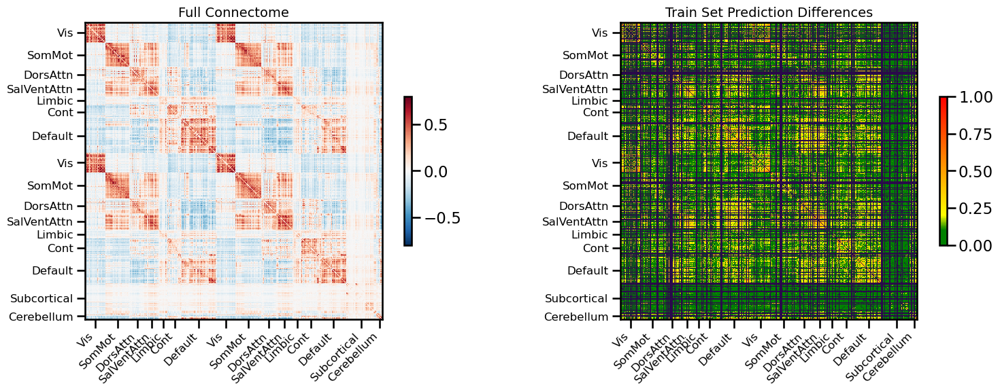

<Figure size 640x480 with 0 Axes>

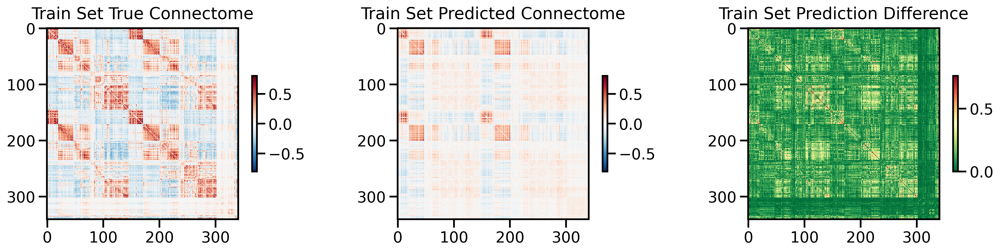

<Figure size 640x480 with 0 Axes>

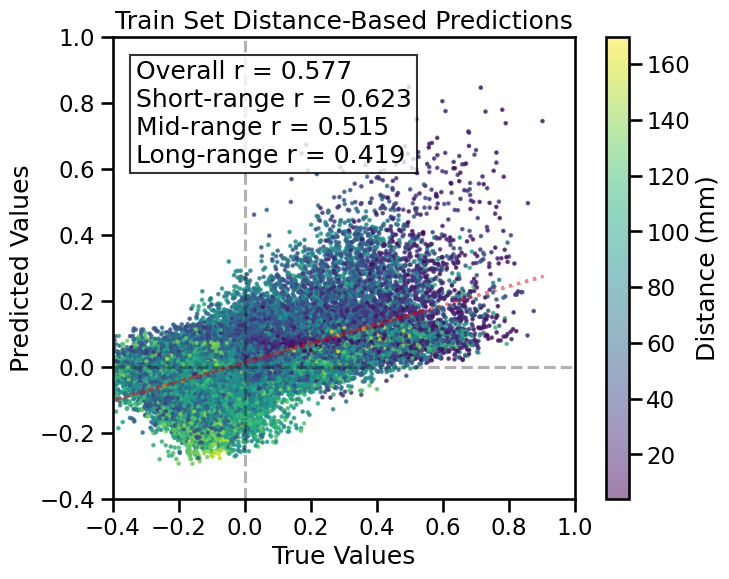

Running test evaluation...

=== TEST EVALUATION ===
Evaluating 114 regions, 12882 connections


<Figure size 640x480 with 0 Axes>

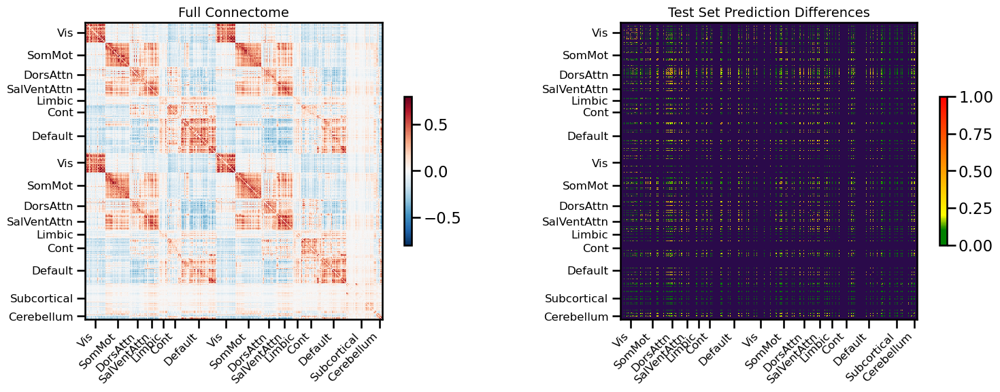

<Figure size 640x480 with 0 Axes>

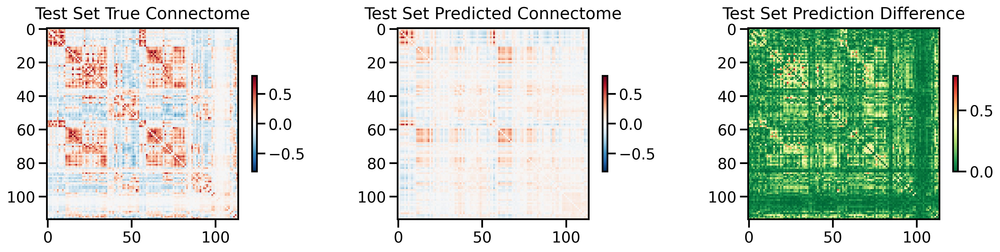

<Figure size 640x480 with 0 Axes>

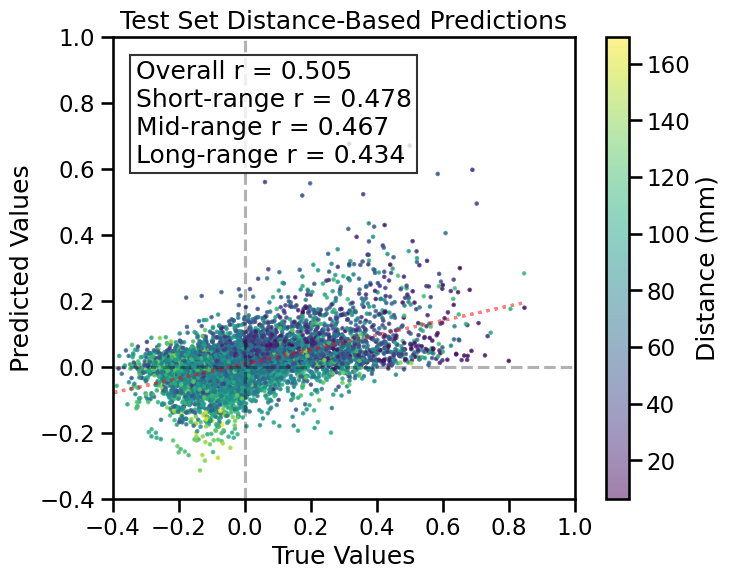

TRAIN METRICS
GLOBAL: mse=0.022794, mae=0.111056, r2=0.3271, pearson_r=0.5773, spearman_r=0.5681, geodesic_distance=34.5467
DISTANCE-BASED: short=0.6226, mid=0.5148, long=0.4190
HEMISPHERIC: left=0.5791, right=0.5846, inter=0.5770
CONNECTION STRENGTH: neg=0.0481, weak=0.4771, pos=0.2308
NETWORK CORRELATIONS:
  NETWORK      INTRA      INTER
  ------------------------------
  Cont          0.6922    0.6383
  Default       0.3425    0.5448
  SalVentAttn    0.7783    0.6764
  Limbic        0.7825    0.6660
  DorsAttn      0.7778    0.6836
  SomMot        0.7139    0.6581
  Vis           0.6323    0.6423
  Subcortical    0.5267    0.5687
  Cerebellum    0.7998    0.5846

TEST METRICS
GLOBAL: mse=0.024630, mae=0.114826, r2=0.2477, pearson_r=0.5054, spearman_r=0.5011, geodesic_distance=20.9621
DISTANCE-BASED: short=0.4780, mid=0.4668, long=0.4341
HEMISPHERIC: left=0.4837, right=0.5635, inter=0.4986
CONNECTION STRENGTH: neg=-0.1649, weak=0.4176, pos=0.1774
NETWORK CORRELATIONS:
  NETWORK      

0

<Figure size 640x480 with 0 Axes>

In [10]:
single_sim_run(
              feature_type=[{'transcriptome': None}],
              train_shared_regions=False,
              test_shared_regions=False,
              omit_subcortical=False,
              dataset='UKBB',
              parcellation='S456',
              hemisphere='both',
              connectome_target='FC',
              impute_strategy='mirror_interpolate',
              sort_genes='refgenome',
              gene_list='100_var',
              cv_type='random',
              random_seed=42,
              search_method=('wandb', 'mse', 2),
              track_wandb=False,
              skip_cv=True,
              model_type='bilinear_lowrank',
              use_gpu=True,
              null_model='none',
              use_folds=[0]
)

# Clear GPU memory
if torch.cuda.is_available():
    torch.cuda.empty_cache()

# Clear CPU memory
gc.collect()

Number of components for 95% variance PCA: 3
Number of 1s: 36662, Number of 0s: 171274, Class balance (1s): 0.176
Number of 1s: 17738, Number of 0s: 190198, Class balance (1s): 0.085
X shape: (455, 100)
X_pca shape: (455, 3)
X_pca_full shape: (455, 100)
X_cell_types_Jorstad shape: (455, 24)
X_cell_types_LakeDFC shape: (455, 18)
X_cell_types_LakeVIS shape: (455, 18)
Y_sc shape: (455, 455)
Y_sc_spectralL shape: (455, 455)
Y_sc_spectralA shape: (455, 456)
Y_fc shape: (455, 455)
Coordinates shape: (455, 3)
connectome target FC
Y shape (455, 455)
feature_name: transcriptome, processing_type: None
features ['transcriptome']
Feature matrix, X, generated... expanding to pairwise dataset


wandb: WARNING Malformed sweep config detected! This may cause your sweep to behave in unexpected ways.
wandb: WARNING To avoid this, please fix the sweep config schema violations below:
wandb: WARNING   Violation 1. Additional properties are not allowed ('best_parameters' was unexpected)


Create sweep with ID: 8vb1ebyy
Sweep URL: https://wandb.ai/alexander-ratzan-new-york-university/gx2conn/sweeps/8vb1ebyy
Initialized sweep with ID: 8vb1ebyy


  warnings.warn(

  self.comm = Comm(**args)

  from IPython.core.display import HTML, display  # type: ignore



2
3
4
BEST CONFIG {'input_dim': 200, 'hidden_dims': [512, 256, 128], 'learning_rate': 9e-05, 'batch_size': 512, 'dropout_rate': 0.1, 'weight_decay': 0.0001, 'epochs': 125}
Number of learnable parameters in MLP: 269057


  from IPython.core.display import HTML, display  # type: ignore



Using device: cuda
GPU 0: NVIDIA H100 80GB HBM3 - Memory Allocated: 0.06 GB
Best val loss so far at epoch 1: 0.0285
Best val loss so far at epoch 2: 0.0247
Best val loss so far at epoch 3: 0.0231
Best val loss so far at epoch 4: 0.0215
Best val loss so far at epoch 5: 0.0203
Epoch 5/125, Train Loss: 0.0310, Val Loss: 0.0203, Time: 1.06s
Best val loss so far at epoch 6: 0.0188
Best val loss so far at epoch 8: 0.0184
Epoch 10/125, Train Loss: 0.0183, Val Loss: 0.0184, Time: 1.03s
Best val loss so far at epoch 11: 0.0180
Best val loss so far at epoch 12: 0.0173
Epoch 15/125, Train Loss: 0.0145, Val Loss: 0.0187, Time: 1.02s
Best val loss so far at epoch 18: 0.0163
Epoch 20/125, Train Loss: 0.0124, Val Loss: 0.0283, Time: 1.55s
Epoch 25/125, Train Loss: 0.0107, Val Loss: 0.0163, Time: 1.02s
Best val loss so far at epoch 27: 0.0158
Epoch 30/125, Train Loss: 0.0094, Val Loss: 0.0176, Time: 1.07s
Epoch 35/125, Train Loss: 0.0085, Val Loss: 0.0235, Time: 1.02s

LR REDUCED: 0.000090 → 0.000027 

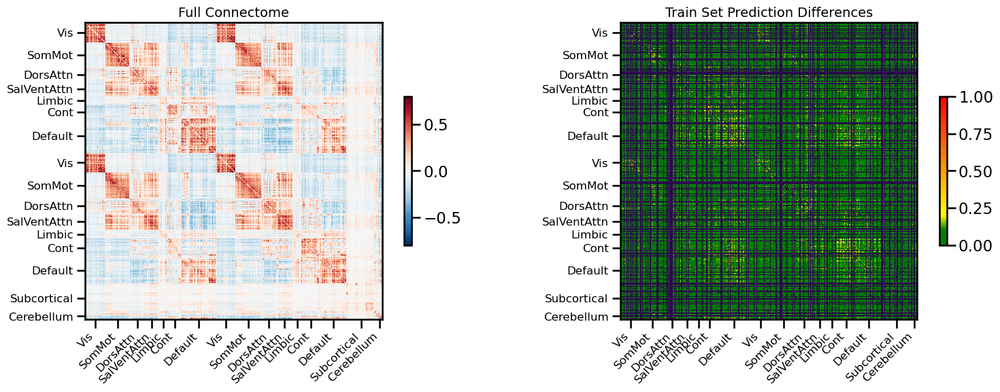

<Figure size 640x480 with 0 Axes>

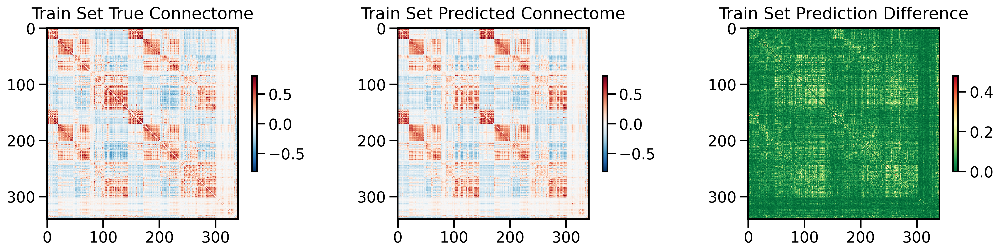

<Figure size 640x480 with 0 Axes>

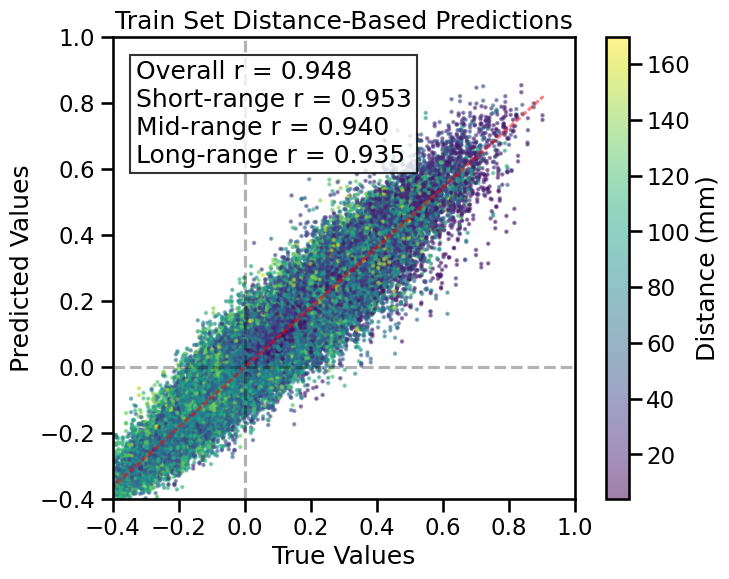

Running test evaluation...

=== TEST EVALUATION ===
Evaluating 114 regions, 12882 connections


<Figure size 640x480 with 0 Axes>

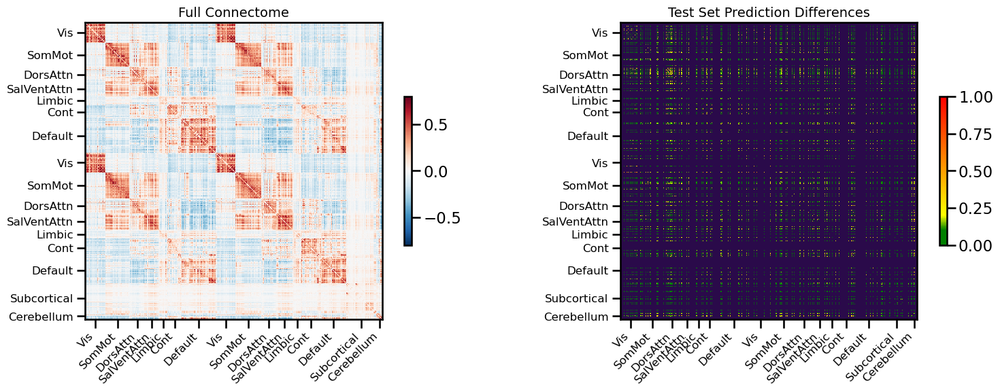

<Figure size 640x480 with 0 Axes>

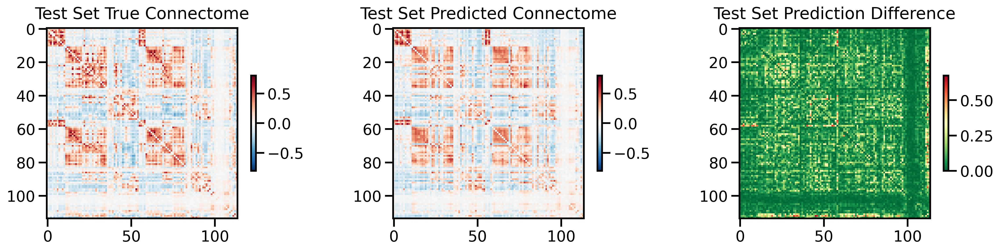

<Figure size 640x480 with 0 Axes>

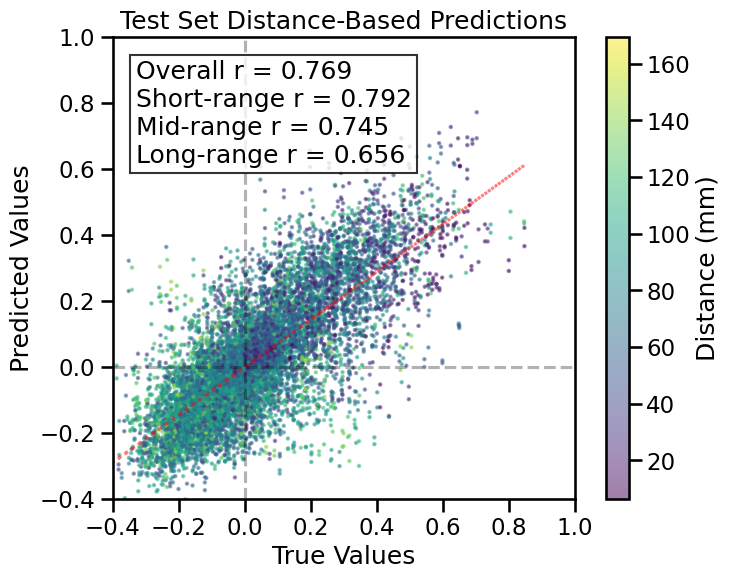

TRAIN METRICS
GLOBAL: mse=0.003470, mae=0.041997, r2=0.8976, pearson_r=0.9475, spearman_r=0.9366, geodesic_distance=17.1097
DISTANCE-BASED: short=0.9528, mid=0.9403, long=0.9353
HEMISPHERIC: left=0.9472, right=0.9532, inter=0.9503
CONNECTION STRENGTH: neg=0.5009, weak=0.9098, pos=0.7217
NETWORK CORRELATIONS:
  NETWORK      INTRA      INTER
  ------------------------------
  Cont          0.9443    0.9464
  Default       0.9173    0.9379
  SalVentAttn    0.9456    0.9525
  Limbic        0.9444    0.9596
  DorsAttn      0.9570    0.9599
  SomMot        0.9717    0.9582
  Vis           0.9761    0.9634
  Subcortical    0.9350    0.9433
  Cerebellum    0.9757    0.9434

TEST METRICS
GLOBAL: mse=0.014408, mae=0.083447, r2=0.5599, pearson_r=0.7686, spearman_r=0.7433, geodesic_distance=11.6120
DISTANCE-BASED: short=0.7923, mid=0.7451, long=0.6559
HEMISPHERIC: left=0.7515, right=0.7901, inter=0.7666
CONNECTION STRENGTH: neg=-0.1490, weak=0.6803, pos=0.3849
NETWORK CORRELATIONS:
  NETWORK      

  from IPython.core.display import HTML, display  # type: ignore



best_val_loss,▁
test_mse_loss,█▆▅▄▄▃▄▂▄▂▂▅▂▂▄▂▂▄▂▁▁▁▂▁▁▂▁▁▂▁▁▁▂▂▁▁▁▁▁▁
train_mse_loss,█▃▃▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
best_val_loss,0
test_mse_loss,0.01426
train_mse_loss,0.00567


Final evaluation metrics logged successfully.
CPU Usage: 48.6%
RAM Usage: 35.3%
Available RAM: 978.4G
Total RAM: 1.5T
| ID | GPU | MEM |
------------------
|  0 |  0% |  1% |
Sim complete
Simulation completed in 164.30 seconds (2.74 minutes)


0

<Figure size 640x480 with 0 Axes>

In [9]:
single_sim_run(
              feature_type=[{'transcriptome': None}],
              train_shared_regions=False,
              test_shared_regions=False,
              omit_subcortical=False,
              dataset='UKBB',
              parcellation='S456',
              hemisphere='both',
              connectome_target='FC',
              impute_strategy='mirror_interpolate',
              sort_genes='refgenome',
              gene_list='100_var',
              cv_type='random',
              random_seed=42,
              search_method=('wandb', 'mse', 2),
              track_wandb=True,
              skip_cv=True,
              model_type='dynamic_mlp',
              use_gpu=True,
              null_model='none',
              use_folds=[0]
)

# Clear GPU memory
if torch.cuda.is_available():
    torch.cuda.empty_cache()

# Clear CPU memory
gc.collect()

Resorting genes by reference genome order
Resorting genes by reference genome order
Number of components for 95% variance PCA: 27
Resorting genes by reference genome order
Number of 1s: 36662, Number of 0s: 171274, Class balance (1s): 0.176
Number of 1s: 17738, Number of 0s: 190198, Class balance (1s): 0.085
X shape: (455, 7380)
X_pca shape: (455, 27)
X_pca_full shape: (455, 455)
Y_sc shape: (455, 455)
Y_sc_spectralL shape: (455, 455)
Y_sc_spectralA shape: (455, 456)
Y_fc shape: (455, 455)
Coordinates shape: (455, 3)
connectome target FC
Y shape (455, 455)
feature_name: transcriptome, processing_type: None
features ['transcriptome']
Feature matrix, X, generated... expanding to pairwise dataset


  return LooseVersion(v) >= LooseVersion(check)

ERROR: Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: Using wandb-core as the SDK backend. Please refer to https://wandb.me/wandb-core for more information.
wandb: Currently logged in as: asratzan (alexander-ratzan-new-york-university). Use `wandb login --relogin` to force relogin
wandb: WARNING Malformed sweep config detected! This may cause your sweep to behave in unexpected ways.
wandb: WARNING To avoid this, please fix the sweep config schema violations below:
wandb: WARNING   Violation 1. Additional properties are not allowed ('best_parameters' was unexpected)


Create sweep with ID: 1jlw8b1f
Sweep URL: https://wandb.ai/alexander-ratzan-new-york-university/gx2conn/sweeps/1jlw8b1f
Initialized sweep with ID: 1jlw8b1f
2
3
4
BEST CONFIG {'input_dim': 14760, 'token_encoder_dim': 60, 'd_model': 128, 'encoder_output_dim': 10, 'use_alibi': True, 'nhead': 4, 'num_layers': 4, 'deep_hidden_dims': [512, 256, 128], 'transformer_dropout': 0.2, 'dropout_rate': 0.2, 'learning_rate': 0.0001, 'weight_decay': 0.0001, 'batch_size': 512, 'aug_prob': 0.3, 'aug_style': 'curriculum_swap_linear_decay', 'epochs': 90, 'num_workers': 2, 'prefetch_factor': 4}


  warnings.warn(



Number of learnable parameters in SMT model: 2162315


  self.comm = Comm(**args)

  from IPython.core.display import HTML, display  # type: ignore



  from IPython.core.display import HTML, display  # type: ignore



Using device: cuda
GPU 0: NVIDIA A100-SXM4-80GB - Memory Allocated: 0.01 GB
Best val loss so far at epoch 1: 0.0377
Best val loss so far at epoch 2: 0.0365
Best val loss so far at epoch 3: 0.0335
Best val loss so far at epoch 4: 0.0312
Epoch 5/90, Train Loss: 0.0813, Val Loss: 0.0361, Time: 11.58s
Best val loss so far at epoch 7: 0.0217
Best val loss so far at epoch 8: 0.0210
Epoch 10/90, Train Loss: 0.0530, Val Loss: 0.0328, Time: 11.59s
Best val loss so far at epoch 11: 0.0189
Best val loss so far at epoch 12: 0.0183
Best val loss so far at epoch 15: 0.0174
Epoch 15/90, Train Loss: 0.0418, Val Loss: 0.0174, Time: 11.92s
Best val loss so far at epoch 18: 0.0169
Epoch 20/90, Train Loss: 0.0421, Val Loss: 0.0187, Time: 11.77s
Epoch 25/90, Train Loss: 0.0310, Val Loss: 0.0169, Time: 10.99s
Best val loss so far at epoch 26: 0.0167
Best val loss so far at epoch 27: 0.0166
Best val loss so far at epoch 29: 0.0158
Epoch 30/90, Train Loss: 0.0347, Val Loss: 0.0179, Time: 12.79s
Best val loss 

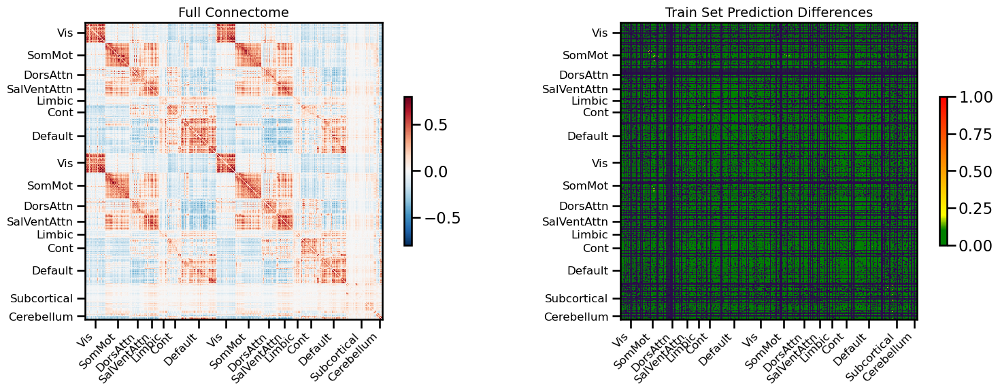

<Figure size 640x480 with 0 Axes>

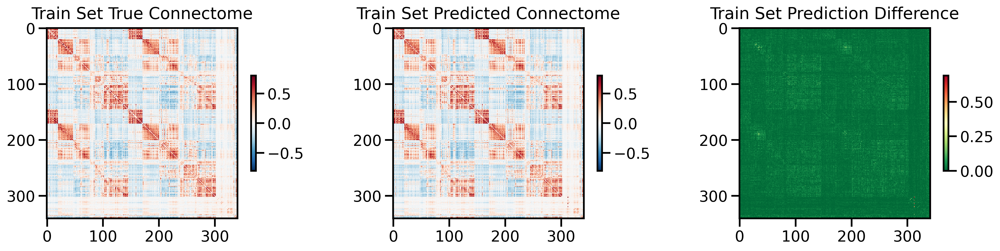

<Figure size 640x480 with 0 Axes>

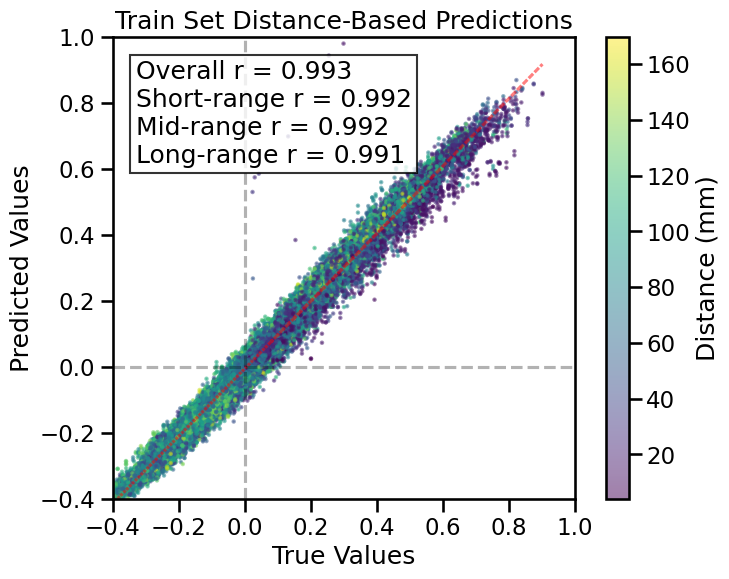

Running test evaluation...

=== TEST EVALUATION ===
Evaluating 114 regions, 12882 connections


<Figure size 640x480 with 0 Axes>

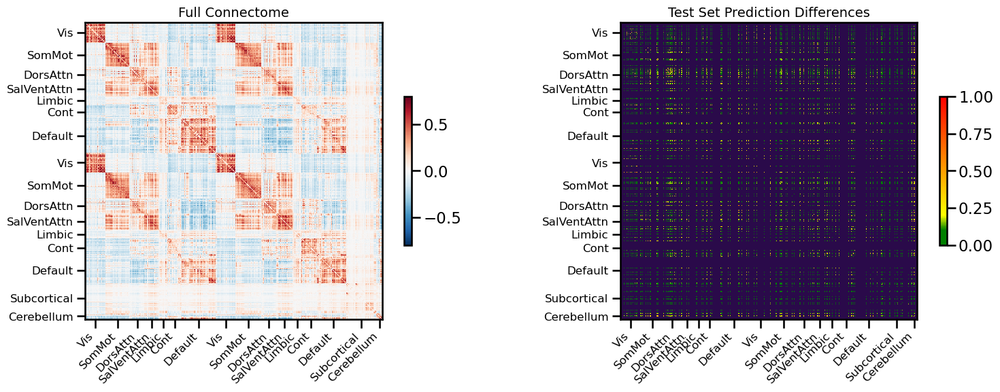

<Figure size 640x480 with 0 Axes>

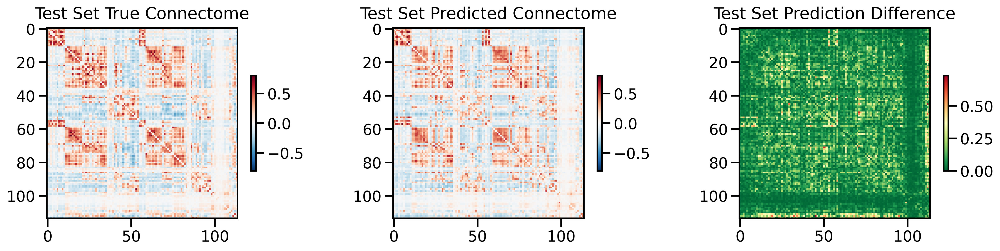

<Figure size 640x480 with 0 Axes>

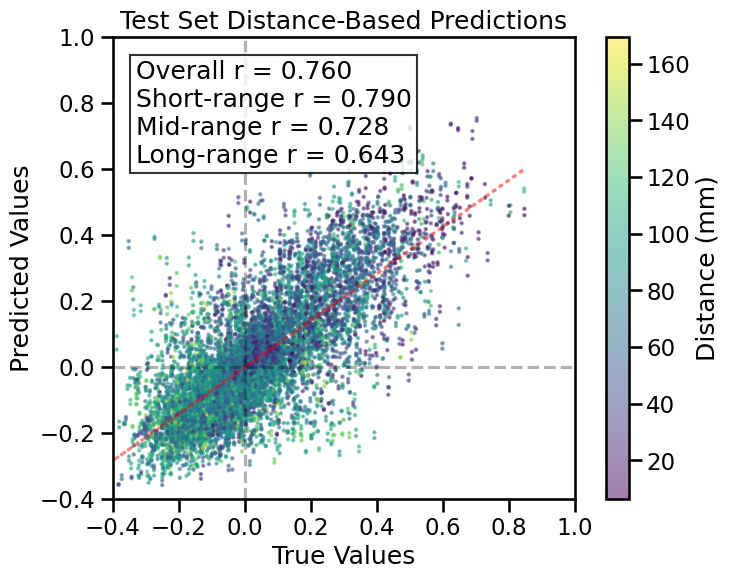

TRAIN METRICS
GLOBAL: mse=0.000569, mae=0.017492, r2=0.9832, pearson_r=0.9925, spearman_r=0.9906, geodesic_distance=12.3923
DISTANCE-BASED: short=0.9924, mid=0.9922, long=0.9915
HEMISPHERIC: left=0.9916, right=0.9934, inter=0.9929
CONNECTION STRENGTH: neg=0.8519, weak=0.9865, pos=0.9496
NETWORK CORRELATIONS:
  NETWORK      INTRA      INTER
  ------------------------------
  Cont          0.9913    0.9923
  Default       0.9883    0.9910
  SalVentAttn    0.9884    0.9921
  Limbic        0.9931    0.9930
  DorsAttn      0.9927    0.9940
  SomMot        0.9948    0.9935
  Vis           0.9954    0.9947
  Subcortical    0.9846    0.9915
  Cerebellum    0.9804    0.9905

TEST METRICS
GLOBAL: mse=0.014860, mae=0.084112, r2=0.5461, pearson_r=0.7600, spearman_r=0.7282, geodesic_distance=9.4754
DISTANCE-BASED: short=0.7905, mid=0.7281, long=0.6430
HEMISPHERIC: left=0.7552, right=0.7979, inter=0.7506
CONNECTION STRENGTH: neg=0.0090, weak=0.6536, pos=0.4232
NETWORK CORRELATIONS:
  NETWORK      IN

  from IPython.core.display import HTML, display  # type: ignore



best_val_loss,▁
test_mse_loss,█▇▃▃▂▂▂▂▂▂▂▂▂▂▁▁▂▁▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
train_loss,█▄▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▁▂▂▁▁▁▁▁▁▁▁▁▁▁
train_mse_loss,█▅▄▄▃▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▁▂▁▁▁▁▁▁▁▁▁▁▁▁
val_loss,█▃▃▃▇▃▃▂▂▂▁▁▁▂▂▂▂▂▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
best_val_loss,0
test_mse_loss,0.01465
train_loss,0.0044
train_mse_loss,0.00179
val_loss,0.01545


Final evaluation metrics logged successfully.
CPU Usage: 24.5%
RAM Usage: 9.5%
Available RAM: 455.5G
Total RAM: 503.0G
| ID | GPU | MEM |
------------------
|  0 |  0% |  1% |
Sim complete
Simulation completed in 1061.37 seconds (17.69 minutes)


12445

<Figure size 640x480 with 0 Axes>

In [8]:
single_sim_run(
              feature_type=[{'transcriptome': None}],
              train_shared_regions=False,
              test_shared_regions=False,
              omit_subcortical=False,
              dataset='UKBB',
              parcellation='S456',
              hemisphere='both',
              connectome_target='FC',
              impute_strategy='mirror_interpolate',
              sort_genes='refgenome',
              gene_list='0.2',
              cv_type='random',
              random_seed=42,
              search_method=('wandb', 'mse', 2),
              track_wandb=True,
              skip_cv=True,
              model_type='shared_transformer',
              use_gpu=True,
              null_model='none',
              use_folds=[0]
)

# Clear GPU memory
if torch.cuda.is_available():
    torch.cuda.empty_cache()

# Clear CPU memory
gc.collect()

Self-attention with vectorized look up

In [8]:
torch._dynamo.reset()

In [9]:
single_sim_run(
              feature_type=[{'transcriptome': None}],
              train_shared_regions=False,
              test_shared_regions=False,
              omit_subcortical=False,
              dataset='UKBB',
              parcellation='S456',
              hemisphere='both',
              connectome_target='FC',
              impute_strategy='mirror_interpolate',
              sort_genes='refgenome',
              gene_list='100_var',
              cv_type='random',
              random_seed=42,
              search_method=('wandb', 'mse', 2),
              track_wandb=True,
              skip_cv=True,
              model_type='self_attention_genevec',
              use_gpu=True,
              null_model='none',
              use_folds=[0]
)

# Clear GPU memory
if torch.cuda.is_available():
    torch.cuda.empty_cache()

# Clear CPU memory
gc.collect()

Resorting genes by reference genome order
Resorting genes by reference genome order
Number of components for 95% variance PCA: 3
Resorting genes by reference genome order
Number of 1s: 36662, Number of 0s: 171274, Class balance (1s): 0.176
Number of 1s: 17738, Number of 0s: 190198, Class balance (1s): 0.085
valid_indices 456
X shape: (455, 100)
X_pca shape: (455, 3)
X_pca_full shape: (455, 100)
Y_sc shape: (455, 455)
Y_sc_spectralL shape: (455, 455)
Y_sc_spectralA shape: (455, 456)
Y_fc shape: (455, 455)
Coordinates shape: (455, 3)
connectome target FC
Y shape (455, 455)
feature_name: transcriptome, processing_type: None
features ['transcriptome']
Feature matrix, X, generated... expanding to pairwise dataset


  return LooseVersion(v) >= LooseVersion(check)

ERROR: Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: Using wandb-core as the SDK backend. Please refer to https://wandb.me/wandb-core for more information.
wandb: Currently logged in as: asratzan (alexander-ratzan-new-york-university). Use `wandb login --relogin` to force relogin
wandb: WARNING Malformed sweep config detected! This may cause your sweep to behave in unexpected ways.
wandb: WARNING To avoid this, please fix the sweep config schema violations below:
wandb: WARNING   Violation 1. Additional properties are not allowed ('best_parameters' was unexpected)


Create sweep with ID: 2jr2g31z
Sweep URL: https://wandb.ai/alexander-ratzan-new-york-university/gx2conn/sweeps/2jr2g31z
Initialized sweep with ID: 2jr2g31z
2
3
4
BEST CONFIG {'input_dim': 200, 'expression_bins': 100, 'genevec_type': 'gene2vec', 'roi_combination': 'concat', 'd_model': 64, 'nhead': 4, 'num_layers': 4, 'deep_hidden_dims': [256, 128, 64], 'pooling_mode': 'attention', 'use_alibi': True, 'transformer_dropout': 0.1, 'dropout_rate': 0.1, 'learning_rate': 9e-05, 'weight_decay': 1e-05, 'batch_size': 1024, 'epochs': 200, 'aug_prob': 0.3, 'aug_style': 'curriculum_swap_linear_decay', 'lambda_sym': 1e-05, 'num_workers': 2, 'prefetch_factor': 4, 'cosine_lr': False}
Using SymmetricLoss with lambda_sym=1e-05
Loaded Gene2Vec embeddings: 94 genes with 200-dimensional embeddings
Gene overlap: 94/100 valid genes have Gene2Vec embeddings


  warnings.warn(



Number of learnable parameters in SelfAttentionGeneVec model: 296578
Expression bins: 100
Pooling mode: attention
ROI combination: concat


  self.comm = Comm(**args)

  from IPython.core.display import HTML, display  # type: ignore



  from IPython.core.display import HTML, display  # type: ignore



Using device: cuda
GPU 0: NVIDIA H100 80GB HBM3 - Memory Allocated: 0.00 GB
Best val loss so far at epoch 1: 0.0338
Best val loss so far at epoch 2: 0.0332
Best val loss so far at epoch 4: 0.0330
Best val loss so far at epoch 5: 0.0328
Epoch 5/200, Train Loss: 0.0778, Val Loss: 0.0328, Time: 4.00s
Best val loss so far at epoch 6: 0.0320
Best val loss so far at epoch 7: 0.0316
Best val loss so far at epoch 8: 0.0314
Best val loss so far at epoch 9: 0.0312
Epoch 10/200, Train Loss: 0.0642, Val Loss: 0.0312, Time: 4.06s
Best val loss so far at epoch 11: 0.0309
Best val loss so far at epoch 13: 0.0306
Best val loss so far at epoch 14: 0.0305
Best val loss so far at epoch 15: 0.0301
Epoch 15/200, Train Loss: 0.0514, Val Loss: 0.0301, Time: 3.87s
Best val loss so far at epoch 17: 0.0288
Best val loss so far at epoch 18: 0.0283
Best val loss so far at epoch 19: 0.0261
Best val loss so far at epoch 20: 0.0251
Epoch 20/200, Train Loss: 0.0421, Val Loss: 0.0251, Time: 3.82s
Best val loss so far 

  gene2vec_df = pd.read_csv(self.gene2vec_path, sep='\s+', header=None, index_col=0)



KeyboardInterrupt: 

Cross-attention

Resorting genes by reference genome order
Resorting genes by reference genome order
Number of components for 95% variance PCA: 3
Resorting genes by reference genome order
Number of 1s: 36662, Number of 0s: 171274, Class balance (1s): 0.176
Number of 1s: 17738, Number of 0s: 190198, Class balance (1s): 0.085
valid_indices 456
X shape: (455, 100)
X_pca shape: (455, 3)
X_pca_full shape: (455, 100)
Y_sc shape: (455, 455)
Y_sc_spectralL shape: (455, 455)
Y_sc_spectralA shape: (455, 456)
Y_fc shape: (455, 455)
Coordinates shape: (455, 3)
connectome target FC
Y shape (455, 455)
feature_name: transcriptome, processing_type: None
features ['transcriptome']
Feature matrix, X, generated... expanding to pairwise dataset


wandb: WARNING Malformed sweep config detected! This may cause your sweep to behave in unexpected ways.
wandb: WARNING To avoid this, please fix the sweep config schema violations below:
wandb: WARNING   Violation 1. Additional properties are not allowed ('best_parameters' was unexpected)


Create sweep with ID: rs4xbjm0
Sweep URL: https://wandb.ai/alexander-ratzan-new-york-university/gx2conn/sweeps/rs4xbjm0
Initialized sweep with ID: rs4xbjm0


  warnings.warn(

  self.comm = Comm(**args)

  from IPython.core.display import HTML, display  # type: ignore



2
3
4
BEST CONFIG {'input_dim': 200, 'expression_bins': 100, 'genevec_type': 'one_hot', 'd_model': 32, 'nhead': 2, 'num_layers': 2, 'deep_hidden_dims': [256, 128, 64], 'pooling_mode': 'attention', 'use_alibi': True, 'transformer_dropout': 0.1, 'dropout_rate': 0.1, 'learning_rate': 9e-05, 'weight_decay': 0.0001, 'batch_size': 1024, 'epochs': 100, 'aug_prob': 0.3, 'aug_style': 'curriculum_swap_linear_decay', 'lambda_sym': 0.0001, 'bidirectional': True, 'num_workers': 2, 'prefetch_factor': 4, 'cosine_lr': False}
Using SymmetricLoss with lambda_sym=0.0001
Created one-hot embeddings: 100 genes with 100-dimensional embeddings
Using all valid genes for one-hot encoding
Number of learnable parameters in CrossAttentionGeneVec model: 85570
Expression bins: 100
Pooling mode: attention


  from IPython.core.display import HTML, display  # type: ignore



Using device: cuda
GPU 0: NVIDIA H100 80GB HBM3 - Memory Allocated: 0.06 GB
Best val loss so far at epoch 1: 0.0404
Best val loss so far at epoch 2: 0.0366
Best val loss so far at epoch 3: 0.0348
Best val loss so far at epoch 4: 0.0333
Best val loss so far at epoch 5: 0.0318
Epoch 5/100, Train Loss: 0.0765, Val Loss: 0.0318, Time: 3.30s
Best val loss so far at epoch 6: 0.0317
Best val loss so far at epoch 7: 0.0314
Best val loss so far at epoch 8: 0.0312
Best val loss so far at epoch 10: 0.0310
Epoch 10/100, Train Loss: 0.0653, Val Loss: 0.0310, Time: 3.44s
Best val loss so far at epoch 11: 0.0310
Best val loss so far at epoch 12: 0.0308
Best val loss so far at epoch 14: 0.0308
Best val loss so far at epoch 15: 0.0307
Epoch 15/100, Train Loss: 0.0502, Val Loss: 0.0307, Time: 3.14s
Best val loss so far at epoch 18: 0.0307
Best val loss so far at epoch 19: 0.0306
Best val loss so far at epoch 20: 0.0305
Epoch 20/100, Train Loss: 0.0479, Val Loss: 0.0305, Time: 3.24s
Best val loss so far 

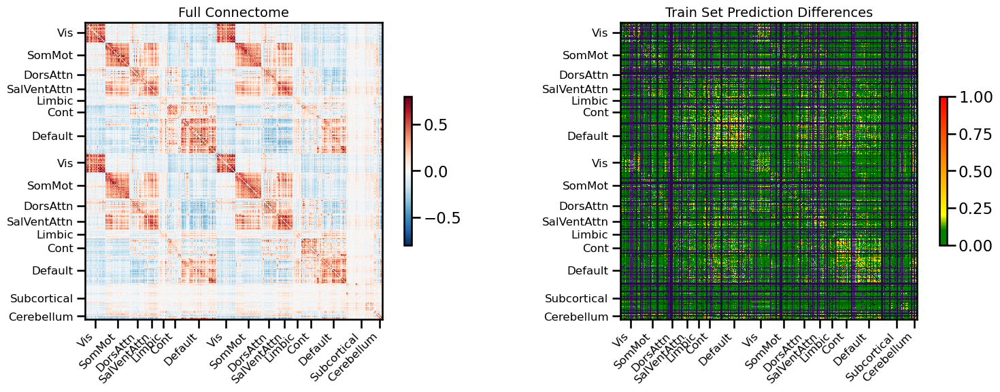

<Figure size 640x480 with 0 Axes>

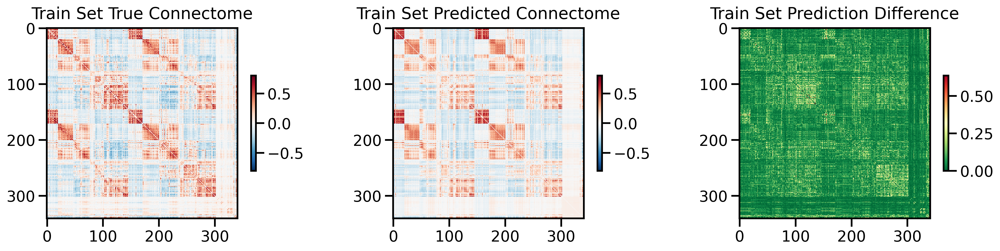

<Figure size 640x480 with 0 Axes>

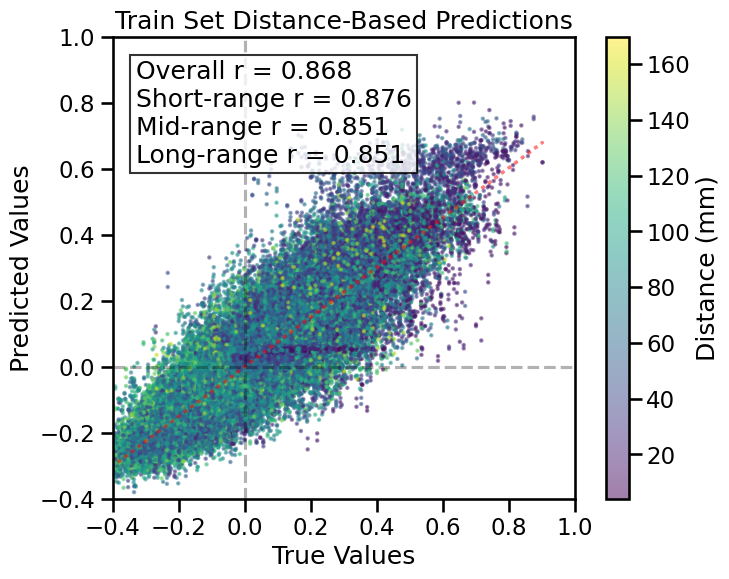

Running test evaluation...

=== TEST EVALUATION ===
Evaluating 114 regions, 12882 connections


<Figure size 640x480 with 0 Axes>

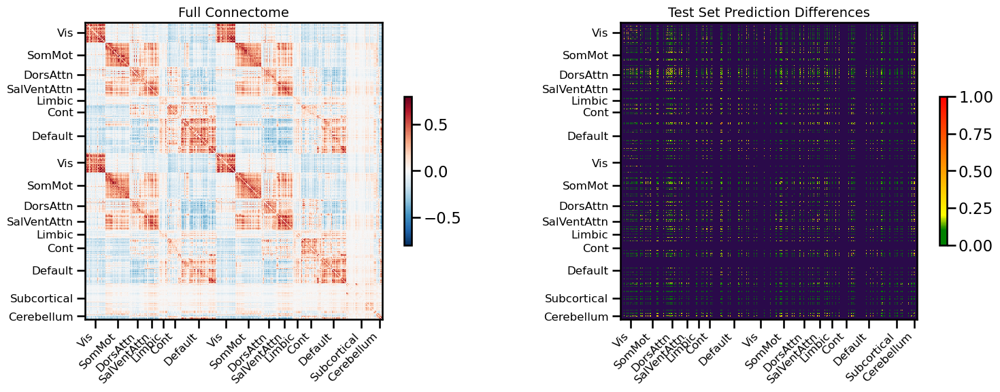

<Figure size 640x480 with 0 Axes>

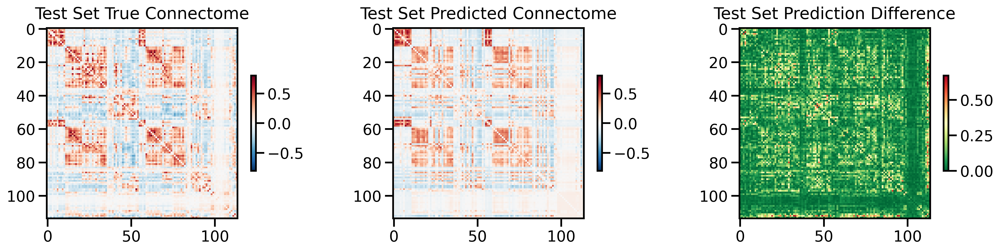

<Figure size 640x480 with 0 Axes>

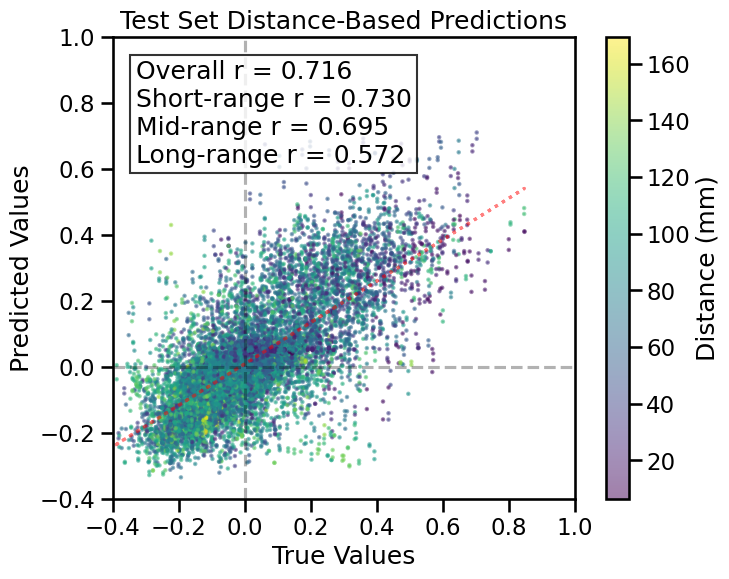

TRAIN METRICS
GLOBAL: mse=0.008347, mae=0.066469, r2=0.7536, pearson_r=0.8683, spearman_r=0.8398, geodesic_distance=22.9754
DISTANCE-BASED: short=0.8757, mid=0.8507, long=0.8509
HEMISPHERIC: left=0.8580, right=0.8823, inter=0.8694
CONNECTION STRENGTH: neg=0.2948, weak=0.7806, pos=0.5516
NETWORK CORRELATIONS:
  NETWORK      INTRA      INTER
  ------------------------------
  Cont          0.8895    0.8766
  Default       0.7917    0.8479
  SalVentAttn    0.8875    0.8823
  Limbic        0.8567    0.8953
  DorsAttn      0.8922    0.8990
  SomMot        0.9011    0.8842
  Vis           0.9192    0.8992
  Subcortical    0.7624    0.8544
  Cerebellum    0.7988    0.8430

TEST METRICS
GLOBAL: mse=0.016806, mae=0.091706, r2=0.4867, pearson_r=0.7158, spearman_r=0.6880, geodesic_distance=13.0208
DISTANCE-BASED: short=0.7303, mid=0.6947, long=0.5723
HEMISPHERIC: left=0.6793, right=0.7708, inter=0.7302
CONNECTION STRENGTH: neg=-0.0273, weak=0.6104, pos=0.3381
NETWORK CORRELATIONS:
  NETWORK      

  from IPython.core.display import HTML, display  # type: ignore



best_val_loss,▁
test_mse_loss,█▆▅▅▅▅▅▅▅▅▅▅▄▅▅▃▂▂▂▂▂▂▂▁▂▁▁▁▁▁▁▁▁▁▂▂▁▁▁▁
train_loss,█▅▄▄▄▃▃▃▂▃▃▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
train_mse_loss,█▅▄▄▄▃▃▃▃▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁
val_loss,█▇▇▇▆▆▆▆▆▆▆▆▆▆▆▅▆▅▄▄▃▃▂▂▂▂▂▂▂▁▁▂▁▁▁▁▁▁▂▁
best_val_loss,0
test_mse_loss,0.01675
train_loss,0.01051
train_mse_loss,0.00987
val_loss,0.0175


Final evaluation metrics logged successfully.
CPU Usage: 5.3%
RAM Usage: 9.7%
Available RAM: 1.3T
Total RAM: 1.5T
| ID | GPU | MEM |
------------------
|  0 |  0% |  2% |
Sim complete
Simulation completed in 358.51 seconds (5.98 minutes)


20830

<Figure size 640x480 with 0 Axes>

In [9]:
single_sim_run(
              feature_type=[{'transcriptome': None}],
              train_shared_regions=False,
              test_shared_regions=False,
              omit_subcortical=False,
              dataset='UKBB',
              parcellation='S456',
              hemisphere='both',
              connectome_target='FC',
              impute_strategy='mirror_interpolate',
              sort_genes='refgenome',
              gene_list='100_var',
              cv_type='random',
              random_seed=42,
              search_method=('wandb', 'mse', 2),
              track_wandb=True,
              skip_cv=True,
              model_type='cross_attention_genevec',
              use_gpu=True,
              null_model='none',
              use_folds=[0]
)

# Clear GPU memory
if torch.cuda.is_available():
    torch.cuda.empty_cache()

# Clear CPU memory
gc.collect()

Mixed attention

Resorting genes by reference genome order
Resorting genes by reference genome order
Number of components for 95% variance PCA: 3
Resorting genes by reference genome order
Number of 1s: 36662, Number of 0s: 171274, Class balance (1s): 0.176
Number of 1s: 17738, Number of 0s: 190198, Class balance (1s): 0.085
valid_indices 456
X shape: (455, 100)
X_pca shape: (455, 3)
X_pca_full shape: (455, 100)
Y_sc shape: (455, 455)
Y_sc_spectralL shape: (455, 455)
Y_sc_spectralA shape: (455, 456)
Y_fc shape: (455, 455)
Coordinates shape: (455, 3)
connectome target FC
Y shape (455, 455)
feature_name: transcriptome, processing_type: None
features ['transcriptome']
Feature matrix, X, generated... expanding to pairwise dataset


wandb: WARNING Malformed sweep config detected! This may cause your sweep to behave in unexpected ways.
wandb: WARNING To avoid this, please fix the sweep config schema violations below:
wandb: WARNING   Violation 1. Additional properties are not allowed ('best_parameters' was unexpected)


Create sweep with ID: mdkuqx4b
Sweep URL: https://wandb.ai/alexander-ratzan-new-york-university/gx2conn/sweeps/mdkuqx4b
Initialized sweep with ID: mdkuqx4b
2
3
4
BEST CONFIG {'input_dim': 200, 'expression_bins': 100, 'genevec_type': 'gene2vec', 'region_emb_init': 'none', 'd_model': 128, 'nhead': 2, 'num_layers': 2, 'deep_hidden_dims': [256, 128, 64], 'pooling_mode': 'attention', 'use_alibi': True, 'transformer_dropout': 0.1, 'dropout_rate': 0.1, 'learning_rate': 0.0001, 'weight_decay': 0.0001, 'batch_size': 512, 'epochs': 100, 'aug_prob': 0.0, 'aug_style': 'curriculum_swap_linear_decay', 'lambda_sym': 0.0, 'num_workers': 2, 'prefetch_factor': 4, 'cosine_lr': False}


  warnings.warn(

  self.comm = Comm(**args)

  from IPython.core.display import HTML, display  # type: ignore



Loaded Gene2Vec embeddings: 94 genes with 200-dimensional embeddings
Gene overlap: 94/100 valid genes have Gene2Vec embeddings
Number of learnable parameters in MixedAttentionGeneVec model: 547586
Expression bins: 100
Region embedding initialization: none


  from IPython.core.display import HTML, display  # type: ignore



Using device: cuda
GPU 0: NVIDIA H100 80GB HBM3 - Memory Allocated: 0.06 GB
Best val loss so far at epoch 1: 0.0521
Best val loss so far at epoch 2: 0.0342
Best val loss so far at epoch 4: 0.0332
Best val loss so far at epoch 5: 0.0332
Epoch 5/100, Train Loss: 0.0486, Val Loss: 0.0332, Time: 1.95s
Best val loss so far at epoch 7: 0.0325
Best val loss so far at epoch 8: 0.0314
Best val loss so far at epoch 10: 0.0290
Epoch 10/100, Train Loss: 0.0329, Val Loss: 0.0290, Time: 1.98s
Best val loss so far at epoch 11: 0.0283
Best val loss so far at epoch 12: 0.0264
Best val loss so far at epoch 13: 0.0231
Best val loss so far at epoch 15: 0.0219
Epoch 15/100, Train Loss: 0.0208, Val Loss: 0.0219, Time: 1.98s
Best val loss so far at epoch 20: 0.0193
Epoch 20/100, Train Loss: 0.0163, Val Loss: 0.0193, Time: 2.01s
Epoch 25/100, Train Loss: 0.0135, Val Loss: 0.0224, Time: 1.90s
Best val loss so far at epoch 27: 0.0190
Best val loss so far at epoch 30: 0.0185
Epoch 30/100, Train Loss: 0.0115, Val

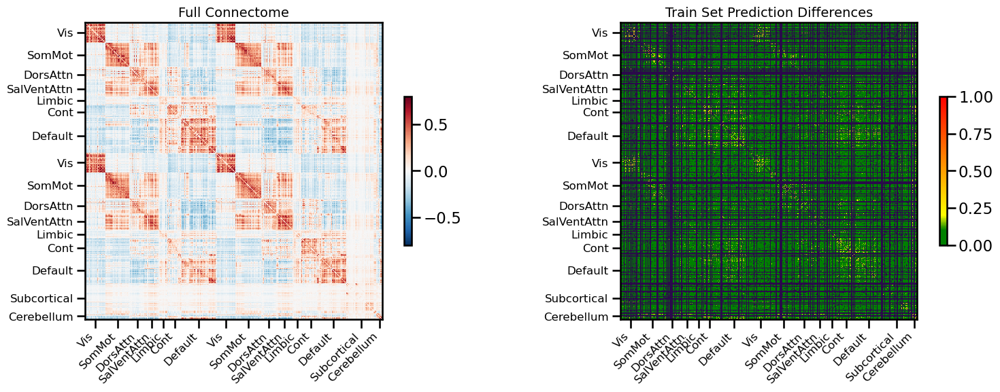

<Figure size 640x480 with 0 Axes>

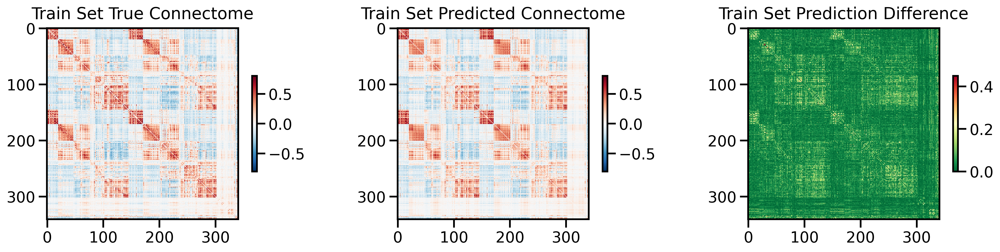

<Figure size 640x480 with 0 Axes>

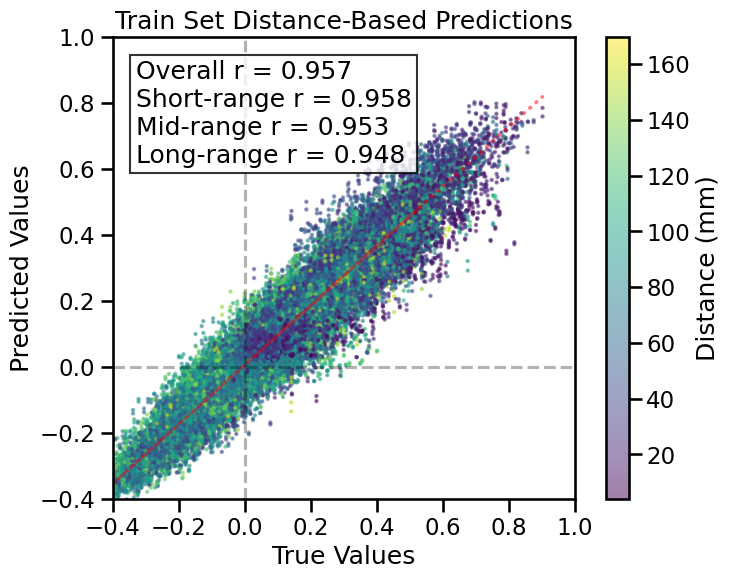

Running test evaluation...

=== TEST EVALUATION ===
Evaluating 114 regions, 12882 connections


<Figure size 640x480 with 0 Axes>

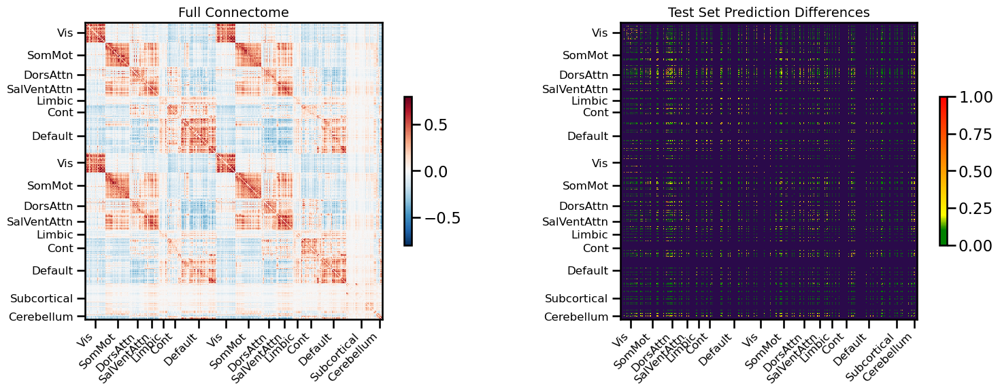

<Figure size 640x480 with 0 Axes>

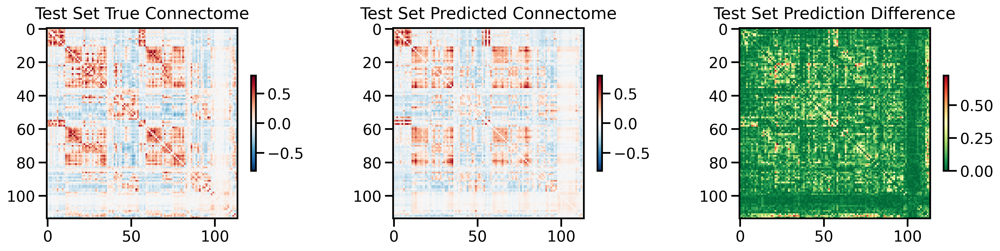

<Figure size 640x480 with 0 Axes>

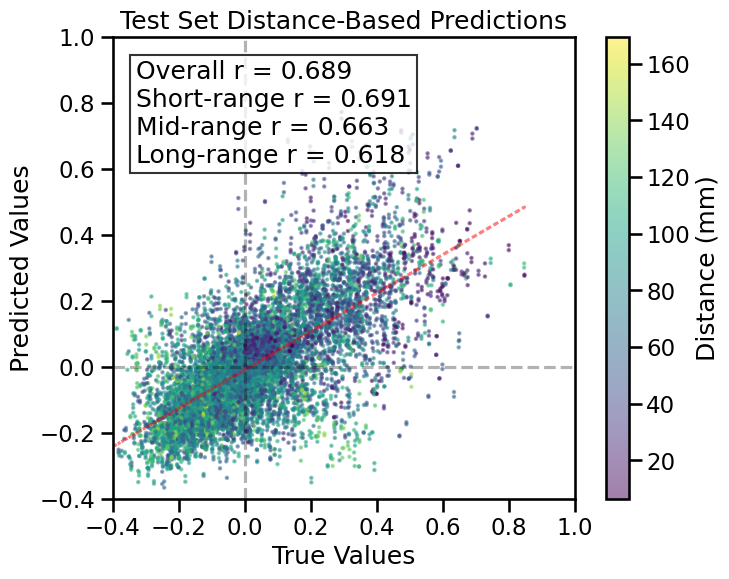

TRAIN METRICS
GLOBAL: mse=0.002888, mae=0.038933, r2=0.9147, pearson_r=0.9569, spearman_r=0.9479, geodesic_distance=19.8190
DISTANCE-BASED: short=0.9584, mid=0.9532, long=0.9479
HEMISPHERIC: left=0.9539, right=0.9631, inter=0.9606
CONNECTION STRENGTH: neg=0.5984, weak=0.9282, pos=0.7310
NETWORK CORRELATIONS:
  NETWORK      INTRA      INTER
  ------------------------------
  Cont          0.9462    0.9557
  Default       0.9319    0.9490
  SalVentAttn    0.9528    0.9554
  Limbic        0.9662    0.9649
  DorsAttn      0.9494    0.9653
  SomMot        0.9719    0.9627
  Vis           0.9775    0.9669
  Subcortical    0.9481    0.9505
  Cerebellum    0.9394    0.9473

TEST METRICS
GLOBAL: mse=0.018321, mae=0.092332, r2=0.4404, pearson_r=0.6894, spearman_r=0.6665, geodesic_distance=14.6208
DISTANCE-BASED: short=0.6912, mid=0.6633, long=0.6180
HEMISPHERIC: left=0.6654, right=0.7382, inter=0.6991
CONNECTION STRENGTH: neg=0.0319, weak=0.6108, pos=0.2701
NETWORK CORRELATIONS:
  NETWORK      I

  from IPython.core.display import HTML, display  # type: ignore



best_val_loss,▁
test_mse_loss,█▅▄▄▄▃▃▂▂▂▂▂▂▂▃▁▂▂▂▂▂▃▁▂▁▁▁▂▁▁▂▁▁▁▁▁▁▁▁▁
train_loss,█▅▅▅▄▃▃▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
train_mse_loss,█▇▆▅▄▃▃▃▃▃▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
val_loss,██▇▇▇▅▅▄▃▄▂▂▃▂▄▃▂▃▂▃▄▃▅▂▂▁▂▂▂▂▂▁▂▂▂▂▂▁▁▂
best_val_loss,0
test_mse_loss,0.01814
train_loss,0.00476
train_mse_loss,0.00474
val_loss,0.01859


Final evaluation metrics logged successfully.
CPU Usage: 5.3%
RAM Usage: 9.7%
Available RAM: 1.3T
Total RAM: 1.5T
| ID | GPU | MEM |
------------------
|  0 |  0% |  1% |
Sim complete
Simulation completed in 244.00 seconds (4.07 minutes)


9818

<Figure size 640x480 with 0 Axes>

In [9]:
single_sim_run(
              feature_type=[{'transcriptome': None}],
              train_shared_regions=False,
              test_shared_regions=False,
              omit_subcortical=False,
              dataset='UKBB',
              parcellation='S456',
              hemisphere='both',
              connectome_target='FC',
              impute_strategy='mirror_interpolate',
              sort_genes='refgenome',
              gene_list='100_var',
              cv_type='random',
              random_seed=42,
              search_method=('wandb', 'mse', 2),
              track_wandb=True,
              skip_cv=True,
              model_type='mixed_attention_genevec',
              use_gpu=True,
              null_model='none',
              use_folds=[0]
)

# Clear GPU memory
if torch.cuda.is_available():
    torch.cuda.empty_cache()

# Clear CPU memory
gc.collect()

Full models

  gene2vec_df = pd.read_csv(self.gene2vec_path, sep='\s+', header=None, index_col=0)



Number of components for 95% variance PCA: 3
Number of 1s: 36662, Number of 0s: 171274, Class balance (1s): 0.176
Number of 1s: 17738, Number of 0s: 190198, Class balance (1s): 0.085
X shape: (455, 100)
X_pca shape: (455, 3)
X_pca_full shape: (455, 100)
X_cell_types_Jorstad shape: (455, 24)
X_cell_types_LakeDFC shape: (455, 18)
X_cell_types_LakeVIS shape: (455, 18)
Y_sc shape: (455, 455)
Y_sc_spectralL shape: (455, 455)
Y_sc_spectralA shape: (455, 456)
Y_fc shape: (455, 455)
Coordinates shape: (455, 3)
connectome target FC
Y shape (455, 455)
feature_name: transcriptome, processing_type: None
features ['transcriptome']
Feature matrix, X, generated... expanding to pairwise dataset


wandb: WARNING Calling wandb.login() after wandb.init() has no effect.
wandb: WARNING Malformed sweep config detected! This may cause your sweep to behave in unexpected ways.
wandb: WARNING To avoid this, please fix the sweep config schema violations below:
wandb: WARNING   Violation 1. Additional properties are not allowed ('best_parameters' was unexpected)


Create sweep with ID: 0by9b3oz
Sweep URL: https://wandb.ai/alexander-ratzan-new-york-university/gx2conn/sweeps/0by9b3oz
Initialized sweep with ID: 0by9b3oz


  warnings.warn(

  self.comm = Comm(**args)

  from IPython.core.display import HTML, display  # type: ignore



2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
50
51
52
53
54
55
56
57
58
59
60
61
62
63
64
65
66
67
68
69
70
71
72
73
74
75
76
77
78
79
80
81
82
83
84
85
86
87
88
89
90
91
92
93
94
95
96
97
98
99
100
BEST CONFIG {'input_dim': 200, 'expression_bins': 5, 'genevec_type': 'one_hot', 'd_model': 32, 'nhead': 2, 'num_layers': 2, 'deep_hidden_dims': [256, 128, 64], 'cls_init': 'random', 'pooling_mode': 'attention', 'use_alibi': True, 'transformer_dropout': 0.1, 'dropout_rate': 0.1, 'learning_rate': 9e-05, 'weight_decay': 0.0001, 'batch_size': 512, 'epochs': 200, 'aug_prob': 0.3, 'aug_style': 'curriculum_swap_linear_decay', 'lambda_sym': 0.0001, 'bidirectional': True, 'num_workers': 2, 'prefetch_factor': 4, 'cosine_lr': False}
Using SymmetricLoss with lambda_sym=0.0001
Created one-hot embeddings: 100 genes with 100-dimensional embeddings
Using all valid genes for one-hot encoding
Number of learnable parame

  from IPython.core.display import HTML, display  # type: ignore



Using device: cuda
GPU 0: NVIDIA H100 80GB HBM3 - Memory Allocated: 0.41 GB
Best val loss so far at epoch 1: 0.0252
Best val loss so far at epoch 3: 0.0229
Best val loss so far at epoch 4: 0.0215
Epoch 5/200, Train Loss: 0.0580, Val Loss: 0.0228, Time: 6.39s
Best val loss so far at epoch 7: 0.0212
Epoch 10/200, Train Loss: 0.0495, Val Loss: 0.0246, Time: 9.07s
Best val loss so far at epoch 12: 0.0191
Best val loss so far at epoch 13: 0.0146
Best val loss so far at epoch 14: 0.0080
Epoch 15/200, Train Loss: 0.0386, Val Loss: 0.0092, Time: 7.94s
Epoch 20/200, Train Loss: 0.0322, Val Loss: 0.0135, Time: 7.60s
Epoch 25/200, Train Loss: 0.0312, Val Loss: 0.0213, Time: 8.82s
Epoch 30/200, Train Loss: 0.0294, Val Loss: 0.0244, Time: 7.88s
Epoch 35/200, Train Loss: 0.0287, Val Loss: 0.0285, Time: 7.97s
Epoch 40/200, Train Loss: 0.0256, Val Loss: 0.0216, Time: 7.77s

LR REDUCED: 0.000090 → 0.000027 at Val Loss: 0.026798
Epoch 45/200, Train Loss: 0.0270, Val Loss: 0.0268, Time: 7.95s
Epoch 50/20

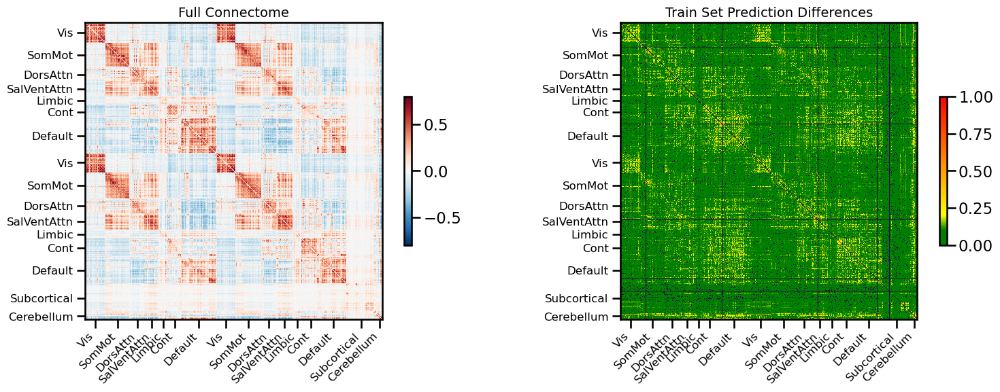

<Figure size 640x480 with 0 Axes>

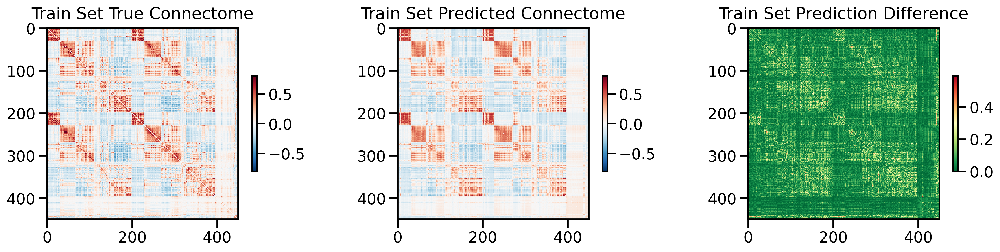

<Figure size 640x480 with 0 Axes>

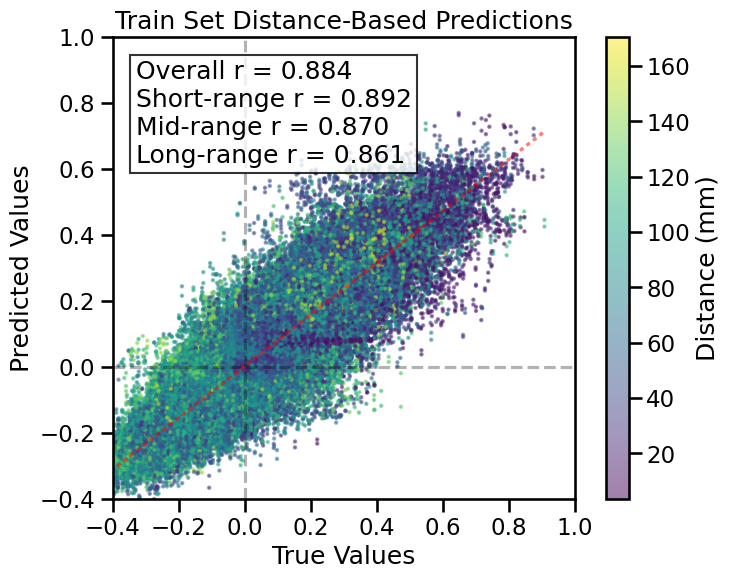

Running test evaluation...

=== TEST EVALUATION ===
Evaluating 5 regions, 20 connections


<Figure size 640x480 with 0 Axes>

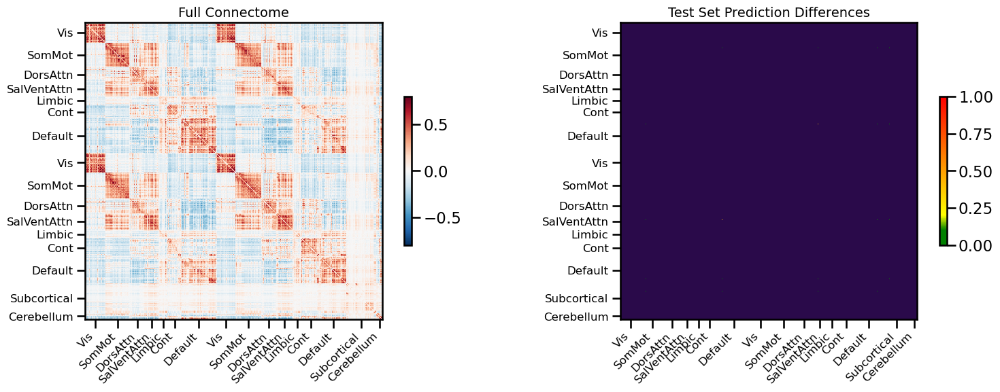

<Figure size 640x480 with 0 Axes>

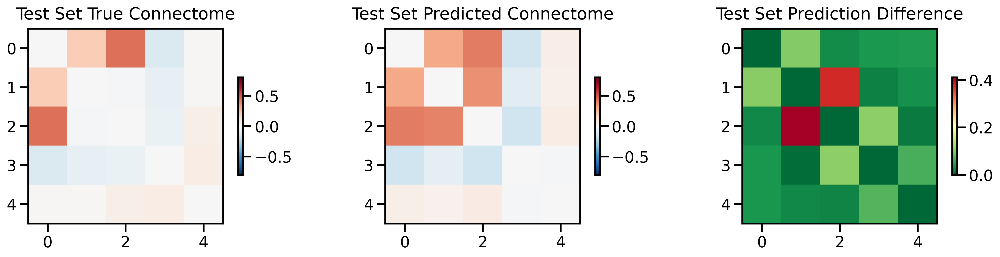

<Figure size 640x480 with 0 Axes>

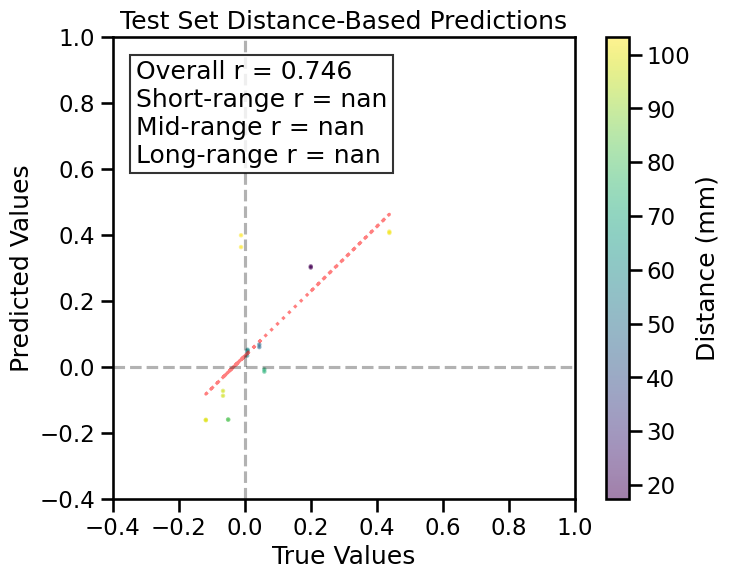

TRAIN METRICS
GLOBAL: mse=0.007335, mae=0.062164, r2=0.7815, pearson_r=0.8840, spearman_r=0.8615, geodesic_distance=23.7670
DISTANCE-BASED: short=0.8916, mid=0.8699, long=0.8608
HEMISPHERIC: left=0.8807, right=0.8974, inter=0.8853
CONNECTION STRENGTH: neg=0.2918, weak=0.8129, pos=0.5200
NETWORK CORRELATIONS:
  NETWORK      INTRA      INTER
  ------------------------------
  Cont          0.9126    0.9098
  Default       0.8559    0.8885
  SalVentAttn    0.8810    0.8919
  Limbic        0.9224    0.9172
  DorsAttn      0.9195    0.9055
  SomMot        0.8969    0.9077
  Vis           0.9228    0.9010
  Subcortical    0.8868    0.8919
  Cerebellum    0.8670    0.8946

TEST METRICS
GLOBAL: mse=0.018831, mae=0.085540, r2=0.1893, pearson_r=0.7462, spearman_r=0.7306, geodesic_distance=4.5121
HEMISPHERIC: left=0.9997, inter=0.7171
NETWORK CORRELATIONS:
  NETWORK      INTRA      INTER
  ------------------------------
  Default          N/A    0.7048
  SalVentAttn       N/A    0.6792
  SomMot  

  from IPython.core.display import HTML, display  # type: ignore



best_val_loss,▁
test_mse_loss,▆▆▆▁▂▇██▆▆▆▆▄▅▇▅▅▆▅▅▅▅▆▅▅▅▅▅▅▅▆▅▅▅▆▅▅▅▅▄
train_mse_loss,█▇▆▄▄▃▃▃▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▂▂▁▂▂▁▁▁▁▁▁▁▁▁
best_val_loss,0
test_mse_loss,0.01908
train_mse_loss,0.01002


Final evaluation metrics logged successfully.
CPU Usage: 28.6%
RAM Usage: 8.7%
Available RAM: 1.3T
Total RAM: 1.5T
| ID | GPU | MEM |
------------------
|  0 |  0% |  3% |
Sim complete
Simulation completed in 1432.56 seconds (23.88 minutes)


15009

<Figure size 640x480 with 0 Axes>

In [9]:
single_sim_run(
              feature_type=[{'transcriptome': None}],
              train_shared_regions=False,
              test_shared_regions=False,
              omit_subcortical=False,
              dataset='UKBB',
              parcellation='S456',
              hemisphere='both',
              connectome_target='FC',
              impute_strategy='mirror_interpolate',
              sort_genes='expression',
              gene_list='100_var',
              cv_type='random_full',
              random_seed=42,
              search_method=('wandb', 'mse', 2),
              track_wandb=True,
              skip_cv=True,
              model_type='cross_attention_genevec',
              use_gpu=True,
              null_model='none',
              use_folds=[0], 
              save_model='UKBB_cross_full'
)

# Clear GPU memory
if torch.cuda.is_available():
    torch.cuda.empty_cache()

# Clear CPU memory
gc.collect()

Number of components for 95% variance PCA: 3
Number of 1s: 36662, Number of 0s: 171274, Class balance (1s): 0.176
Number of 1s: 17738, Number of 0s: 190198, Class balance (1s): 0.085
X shape: (455, 100)
X_pca shape: (455, 3)
X_pca_full shape: (455, 100)
X_cell_types_Jorstad shape: (455, 24)
X_cell_types_LakeDFC shape: (455, 18)
X_cell_types_LakeVIS shape: (455, 18)
Y_sc shape: (455, 455)
Y_sc_spectralL shape: (455, 455)
Y_sc_spectralA shape: (455, 456)
Y_fc shape: (455, 455)
Coordinates shape: (455, 3)
connectome target FC
Y shape (455, 455)
feature_name: transcriptome, processing_type: None
features ['transcriptome']
Feature matrix, X, generated... expanding to pairwise dataset


wandb: WARNING Malformed sweep config detected! This may cause your sweep to behave in unexpected ways.
wandb: WARNING To avoid this, please fix the sweep config schema violations below:
wandb: WARNING   Violation 1. Additional properties are not allowed ('best_parameters' was unexpected)


Create sweep with ID: kgcbmmce
Sweep URL: https://wandb.ai/alexander-ratzan-new-york-university/gx2conn/sweeps/kgcbmmce
Initialized sweep with ID: kgcbmmce


  warnings.warn(

  self.comm = Comm(**args)

  from IPython.core.display import HTML, display  # type: ignore



2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
50
51
52
53
54
55
56
57
58
59
60
61
62
63
64
65
66
67
68
69
70
71
72
73
74
75
76
77
78
79
80
81
82
83
84
85
86
87
88
89
90
91
92
93
94
95
96
97
98
99
100
BEST CONFIG {'input_dim': 200, 'learning_rate': 0.0005, 'batch_size': 512, 'regularization': 'l2', 'lambda_reg': 0.1, 'epochs': 100}
Total number of learnable parameters in BilinearCMmodel: 10001


  from IPython.core.display import HTML, display  # type: ignore



Running train evaluation...

=== TRAIN EVALUATION ===
Evaluating 450 regions, 202050 connections


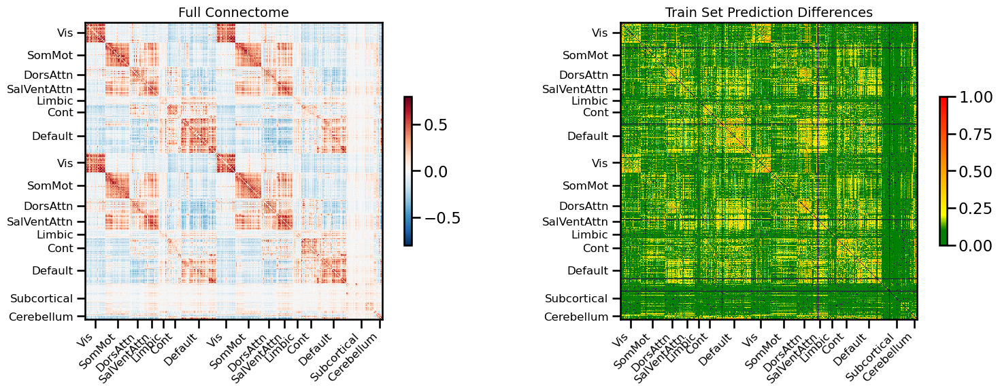

<Figure size 640x480 with 0 Axes>

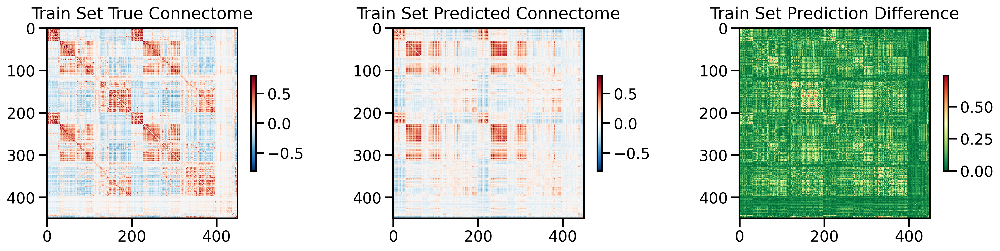

<Figure size 640x480 with 0 Axes>

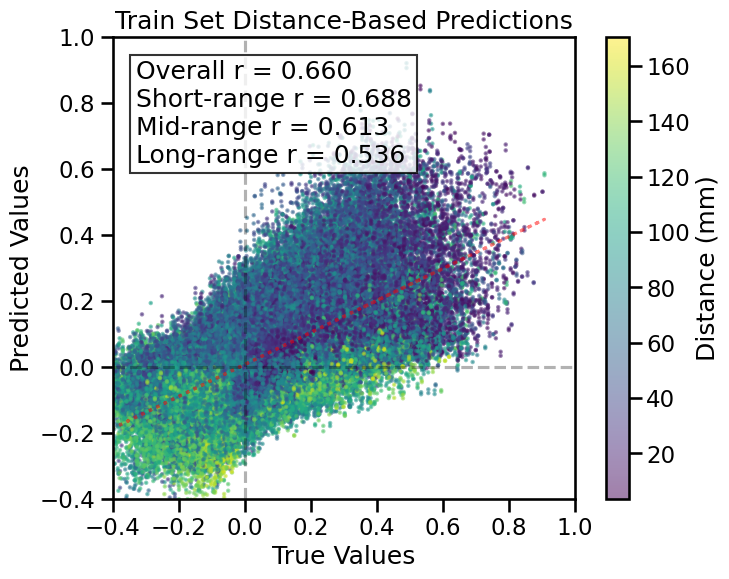

Running test evaluation...

=== TEST EVALUATION ===
Evaluating 5 regions, 20 connections


<Figure size 640x480 with 0 Axes>

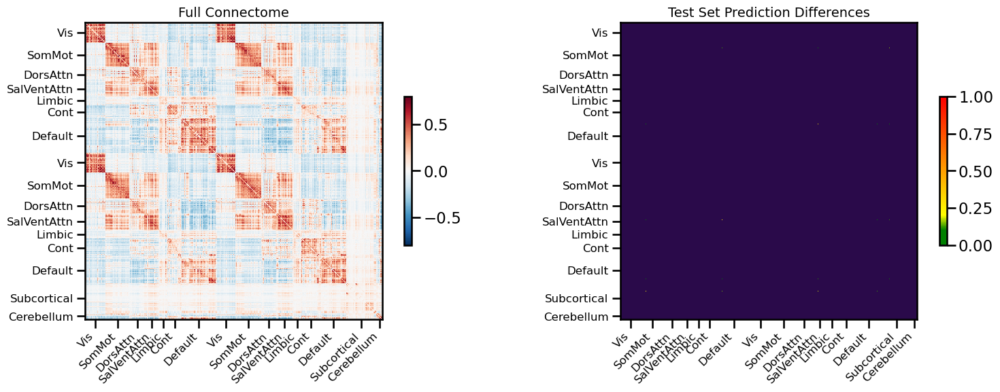

<Figure size 640x480 with 0 Axes>

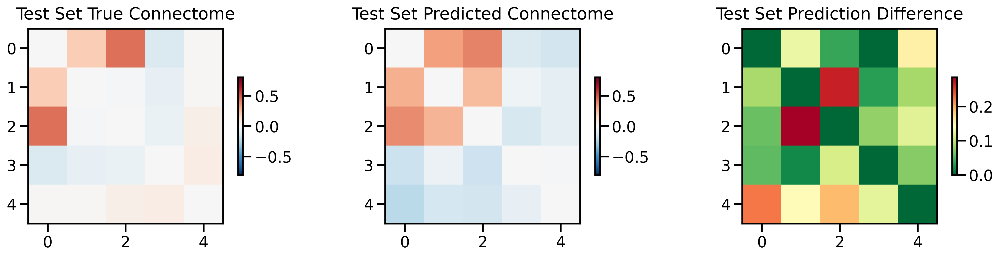

<Figure size 640x480 with 0 Axes>

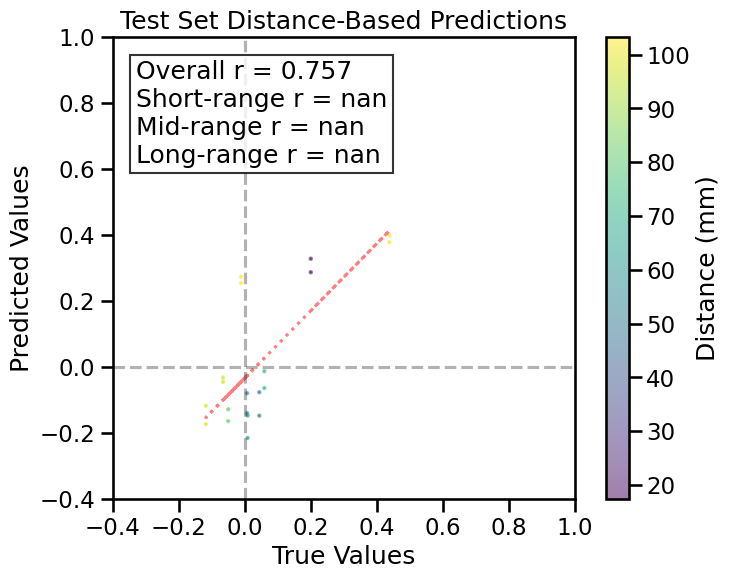

TRAIN METRICS
GLOBAL: mse=0.019142, mae=0.104683, r2=0.4298, pearson_r=0.6598, spearman_r=0.6251, geodesic_distance=33.0107
DISTANCE-BASED: short=0.6880, mid=0.6126, long=0.5359
HEMISPHERIC: left=0.6430, right=0.6641, inter=0.6731
CONNECTION STRENGTH: neg=0.0240, weak=0.5619, pos=0.2078
NETWORK CORRELATIONS:
  NETWORK      INTRA      INTER
  ------------------------------
  Cont          0.7917    0.7409
  Default       0.4775    0.6681
  SalVentAttn    0.7864    0.7388
  Limbic        0.7290    0.7449
  DorsAttn      0.7850    0.7624
  SomMot        0.6906    0.7454
  Vis           0.7269    0.7050
  Subcortical    0.4966    0.6861
  Cerebellum    0.4618    0.6804

TEST METRICS
GLOBAL: mse=0.018921, mae=0.114193, r2=0.1854, pearson_r=0.7575, spearman_r=0.5223, geodesic_distance=4.0210
HEMISPHERIC: left=0.9905, inter=0.7768
NETWORK CORRELATIONS:
  NETWORK      INTRA      INTER
  ------------------------------
  Default          N/A    0.7359
  SalVentAttn       N/A    0.6152
  SomMot  

  from IPython.core.display import HTML, display  # type: ignore



best_val_loss,▁
test_mse_loss,▁
train_mse_loss,▁
best_val_loss,0
test_mse_loss,4.996
train_mse_loss,4.99622


Final evaluation metrics logged successfully.
CPU Usage: 1.5%
RAM Usage: 6.1%
Available RAM: 1.4T
Total RAM: 1.5T
| ID | GPU | MEM |
------------------
|  0 |  0% |  2% |
Sim complete
Simulation completed in 84.47 seconds (1.41 minutes)


0

<Figure size 640x480 with 0 Axes>

In [13]:
single_sim_run(
              feature_type=[{'transcriptome': None}],
              train_shared_regions=False,
              test_shared_regions=False,
              omit_subcortical=False,
              dataset='UKBB',
              parcellation='S456',
              hemisphere='both',
              connectome_target='FC',
              impute_strategy='mirror_interpolate',
              sort_genes='expression',
              gene_list='100_var',
              cv_type='random_full',
              random_seed=42,
              search_method=('wandb', 'mse', 2),
              track_wandb=True,
              skip_cv=True,
              model_type='bilinear_CM',
              use_gpu=True,
              null_model='none',
              use_folds=[0], 
              save_model='UKBB_CM_full'
)

# Clear GPU memory
if torch.cuda.is_available():
    torch.cuda.empty_cache()

# Clear CPU memory
gc.collect()

Number of components for 95% variance PCA: 3
Number of 1s: 36662, Number of 0s: 171274, Class balance (1s): 0.176
Number of 1s: 11988, Number of 0s: 195948, Class balance (1s): 0.058
X shape: (455, 100)
X_pca shape: (455, 3)
X_pca_full shape: (455, 100)
X_cell_types_Jorstad shape: (455, 24)
X_cell_types_LakeDFC shape: (455, 18)
X_cell_types_LakeVIS shape: (455, 18)
Y_sc shape: (455, 455)
Y_sc_spectralL shape: (455, 455)
Y_sc_spectralA shape: (455, 456)
Y_fc shape: (455, 455)
Coordinates shape: (455, 3)
connectome target FC
Y shape (455, 455)
feature_name: transcriptome, processing_type: None
features ['transcriptome']
Feature matrix, X, generated... expanding to pairwise dataset


wandb: WARNING Malformed sweep config detected! This may cause your sweep to behave in unexpected ways.
wandb: WARNING To avoid this, please fix the sweep config schema violations below:
wandb: WARNING   Violation 1. Additional properties are not allowed ('best_parameters' was unexpected)


Create sweep with ID: aj2icj0z
Sweep URL: https://wandb.ai/alexander-ratzan-new-york-university/gx2conn/sweeps/aj2icj0z
Initialized sweep with ID: aj2icj0z


  warnings.warn(

  self.comm = Comm(**args)

  from IPython.core.display import HTML, display  # type: ignore



2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
50
51
52
53
54
55
56
57
58
59
60
61
62
63
64
65
66
67
68
69
70
71
72
73
74
75
76
77
78
79
80
81
82
83
84
85
86
87
88
89
90
91
92
93
94
95
96
97
98
99
100
BEST CONFIG {'input_dim': 200, 'expression_bins': 5, 'genevec_type': 'one_hot', 'd_model': 32, 'nhead': 2, 'num_layers': 2, 'deep_hidden_dims': [256, 128, 64], 'cls_init': 'random', 'pooling_mode': 'attention', 'use_alibi': True, 'transformer_dropout': 0.1, 'dropout_rate': 0.1, 'learning_rate': 9e-05, 'weight_decay': 0.0001, 'batch_size': 512, 'epochs': 200, 'aug_prob': 0.3, 'aug_style': 'curriculum_swap_linear_decay', 'lambda_sym': 0.0001, 'bidirectional': True, 'num_workers': 2, 'prefetch_factor': 4, 'cosine_lr': False}
Using SymmetricLoss with lambda_sym=0.0001
Created one-hot embeddings: 100 genes with 100-dimensional embeddings
Using all valid genes for one-hot encoding
Number of learnable parame

  from IPython.core.display import HTML, display  # type: ignore



Using device: cuda
GPU 0: NVIDIA H100 80GB HBM3 - Memory Allocated: 0.41 GB
Best val loss so far at epoch 1: 0.0132
Best val loss so far at epoch 3: 0.0131
Best val loss so far at epoch 4: 0.0130
Epoch 5/200, Train Loss: 0.0346, Val Loss: 0.0133, Time: 6.39s
Best val loss so far at epoch 6: 0.0126
Best val loss so far at epoch 7: 0.0117
Best val loss so far at epoch 8: 0.0115
Best val loss so far at epoch 9: 0.0114
Epoch 10/200, Train Loss: 0.0259, Val Loss: 0.0117, Time: 6.42s
Best val loss so far at epoch 12: 0.0106
Best val loss so far at epoch 15: 0.0091
Epoch 15/200, Train Loss: 0.0233, Val Loss: 0.0091, Time: 6.61s
Best val loss so far at epoch 17: 0.0053
Best val loss so far at epoch 19: 0.0048
Best val loss so far at epoch 20: 0.0047
Epoch 20/200, Train Loss: 0.0197, Val Loss: 0.0047, Time: 6.61s
Epoch 25/200, Train Loss: 0.0174, Val Loss: 0.0076, Time: 6.46s
Epoch 30/200, Train Loss: 0.0162, Val Loss: 0.0059, Time: 6.61s
Epoch 35/200, Train Loss: 0.0158, Val Loss: 0.0051, Time

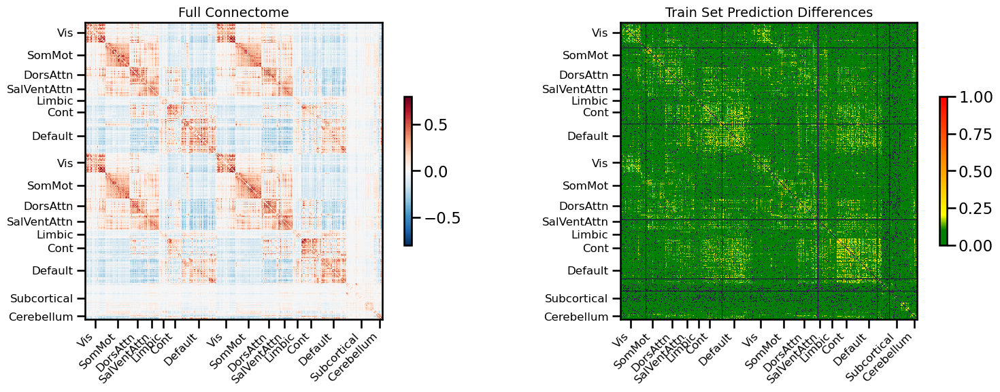

<Figure size 640x480 with 0 Axes>

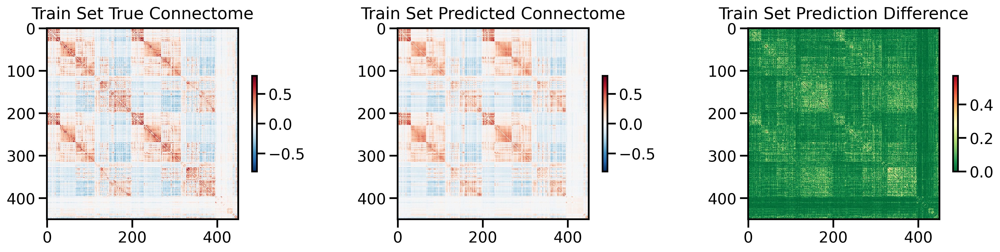

<Figure size 640x480 with 0 Axes>

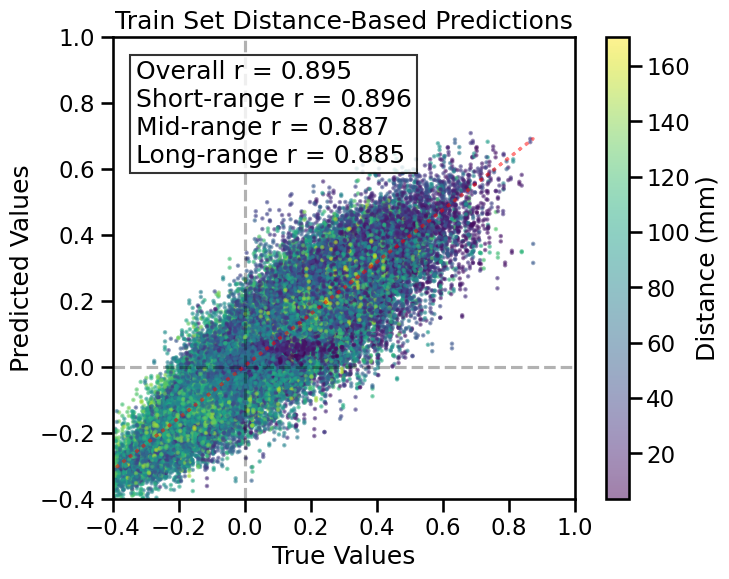

Running test evaluation...

=== TEST EVALUATION ===
Evaluating 5 regions, 20 connections


<Figure size 640x480 with 0 Axes>

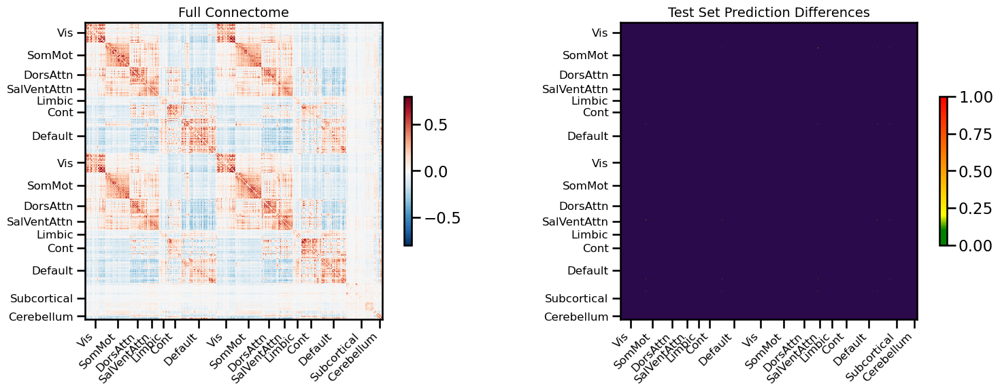

<Figure size 640x480 with 0 Axes>

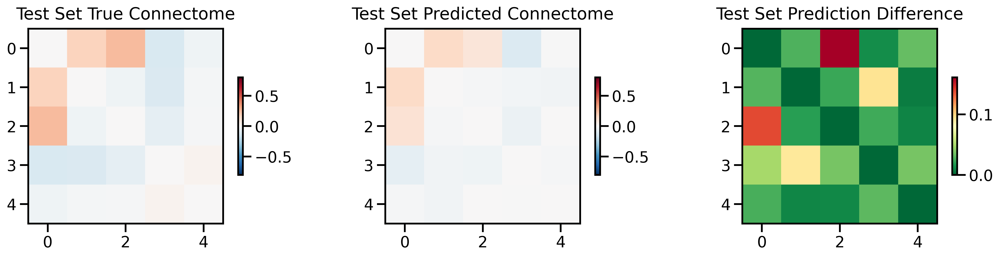

<Figure size 640x480 with 0 Axes>

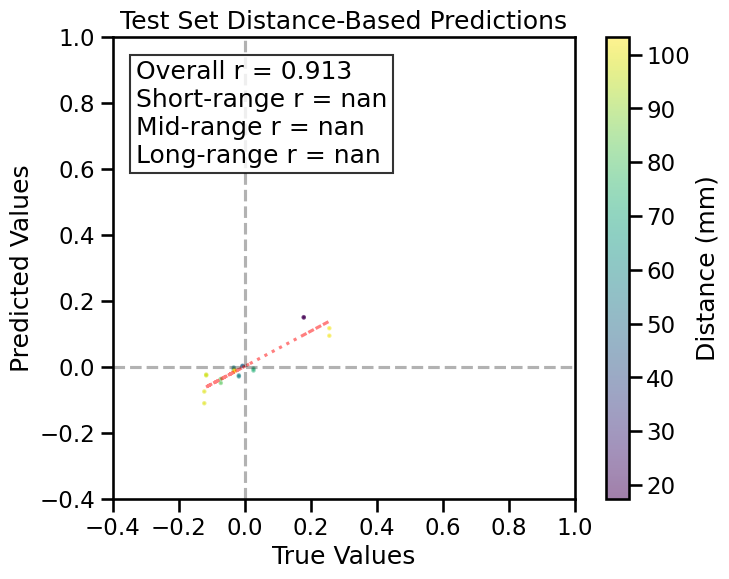

TRAIN METRICS
GLOBAL: mse=0.004899, mae=0.048620, r2=0.8012, pearson_r=0.8953, spearman_r=0.8804, geodesic_distance=22.6234
DISTANCE-BASED: short=0.8955, mid=0.8873, long=0.8853
HEMISPHERIC: left=0.8950, right=0.8938, inter=0.9027
CONNECTION STRENGTH: neg=0.4133, weak=0.8562, pos=0.4850
NETWORK CORRELATIONS:
  NETWORK      INTRA      INTER
  ------------------------------
  Cont          0.9010    0.9098
  Default       0.9036    0.9057
  SalVentAttn    0.8966    0.9032
  Limbic        0.9238    0.9230
  DorsAttn      0.9319    0.9172
  SomMot        0.9152    0.9161
  Vis           0.9172    0.9072
  Subcortical    0.8853    0.9066
  Cerebellum    0.8648    0.9078

TEST METRICS
GLOBAL: mse=0.003688, mae=0.043541, r2=0.7257, pearson_r=0.9130, spearman_r=0.8302, geodesic_distance=1.5660
HEMISPHERIC: left=0.9819, inter=0.8950
NETWORK CORRELATIONS:
  NETWORK      INTRA      INTER
  ------------------------------
  Default          N/A    0.9116
  SalVentAttn       N/A    0.9923
  SomMot  

  from IPython.core.display import HTML, display  # type: ignore



best_val_loss,▁
test_mse_loss,███▇▇▅▄▃▃▂▂▂▂▁▃▂▂▃▃▄▂▃▃▃▃▃▂▂▃▂▃▂▂▂▂▂▂▃▂▂
train_mse_loss,█▇▆▅▅▄▄▄▄▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
best_val_loss,0
test_mse_loss,0.00377
train_mse_loss,0.00671


Final evaluation metrics logged successfully.
CPU Usage: 28.7%
RAM Usage: 10.7%
Available RAM: 1.3T
Total RAM: 1.5T
| ID | GPU | MEM |
------------------
|  0 |  0% |  4% |
Sim complete
Simulation completed in 1325.04 seconds (22.08 minutes)


15039

<Figure size 640x480 with 0 Axes>

In [10]:
single_sim_run(
              feature_type=[{'transcriptome': None}],
              train_shared_regions=False,
              test_shared_regions=False,
              omit_subcortical=False,
              dataset='HCP',
              parcellation='S456',
              hemisphere='both',
              connectome_target='FC',
              impute_strategy='mirror_interpolate',
              sort_genes='expression',
              gene_list='100_var',
              cv_type='random_full',
              random_seed=42,
              search_method=('wandb', 'mse', 2),
              track_wandb=True,
              skip_cv=True,
              model_type='cross_attention_genevec',
              use_gpu=True,
              null_model='none',
              use_folds=[0], 
              save_model='HCP_cross_full'
)

# Clear GPU memory
if torch.cuda.is_available():
    torch.cuda.empty_cache()

# Clear CPU memory
gc.collect()

Number of components for 95% variance PCA: 3
Number of 1s: 36662, Number of 0s: 171274, Class balance (1s): 0.176
Number of 1s: 11988, Number of 0s: 195948, Class balance (1s): 0.058
X shape: (455, 100)
X_pca shape: (455, 3)
X_pca_full shape: (455, 100)
X_cell_types_Jorstad shape: (455, 24)
X_cell_types_LakeDFC shape: (455, 18)
X_cell_types_LakeVIS shape: (455, 18)
Y_sc shape: (455, 455)
Y_sc_spectralL shape: (455, 455)
Y_sc_spectralA shape: (455, 456)
Y_fc shape: (455, 455)
Coordinates shape: (455, 3)
connectome target FC
Y shape (455, 455)
feature_name: transcriptome, processing_type: None
features ['transcriptome']
Feature matrix, X, generated... expanding to pairwise dataset


wandb: WARNING Malformed sweep config detected! This may cause your sweep to behave in unexpected ways.
wandb: WARNING To avoid this, please fix the sweep config schema violations below:
wandb: WARNING   Violation 1. Additional properties are not allowed ('best_parameters' was unexpected)


Create sweep with ID: 3w0983zf
Sweep URL: https://wandb.ai/alexander-ratzan-new-york-university/gx2conn/sweeps/3w0983zf
Initialized sweep with ID: 3w0983zf


  warnings.warn(

  self.comm = Comm(**args)

  from IPython.core.display import HTML, display  # type: ignore



2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
50
51
52
53
54
55
56
57
58
59
60
61
62
63
64
65
66
67
68
69
70
71
72
73
74
75
76
77
78
79
80
81
82
83
84
85
86
87
88
89
90
91
92
93
94
95
96
97
98
99
100
BEST CONFIG {'input_dim': 200, 'learning_rate': 0.0005, 'batch_size': 512, 'regularization': 'l2', 'lambda_reg': 0.1, 'epochs': 100}
Total number of learnable parameters in BilinearCMmodel: 10001


  from IPython.core.display import display



  from IPython.core.display import HTML, display  # type: ignore



Running train evaluation...

=== TRAIN EVALUATION ===
Evaluating 450 regions, 202050 connections


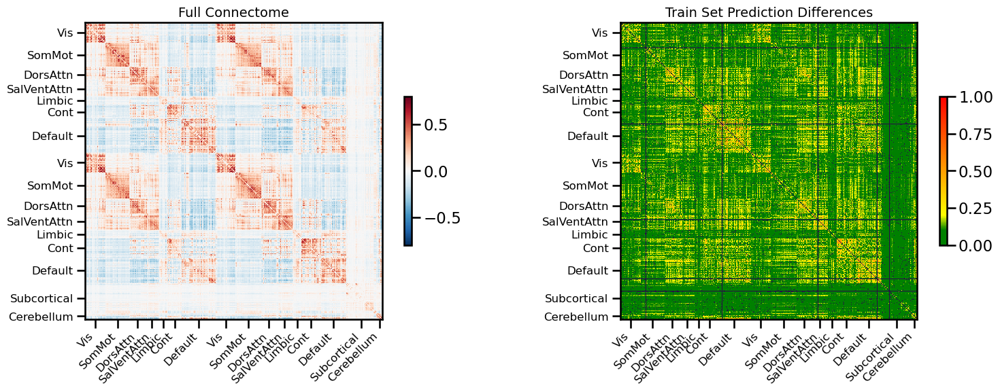

<Figure size 640x480 with 0 Axes>

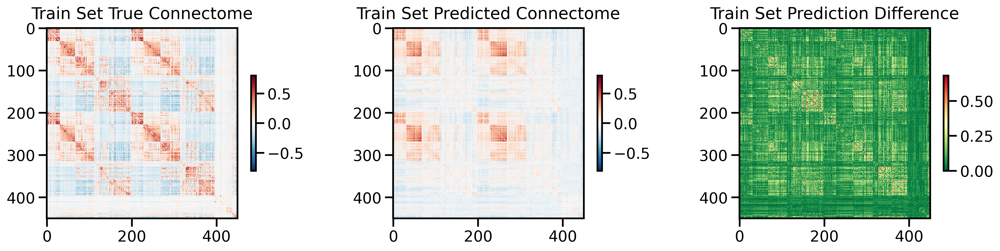

<Figure size 640x480 with 0 Axes>

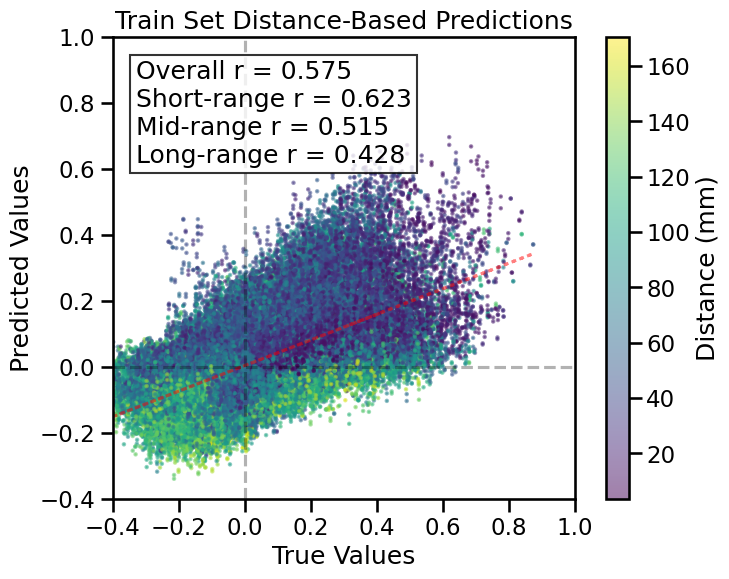

Running test evaluation...

=== TEST EVALUATION ===
Evaluating 5 regions, 20 connections


<Figure size 640x480 with 0 Axes>

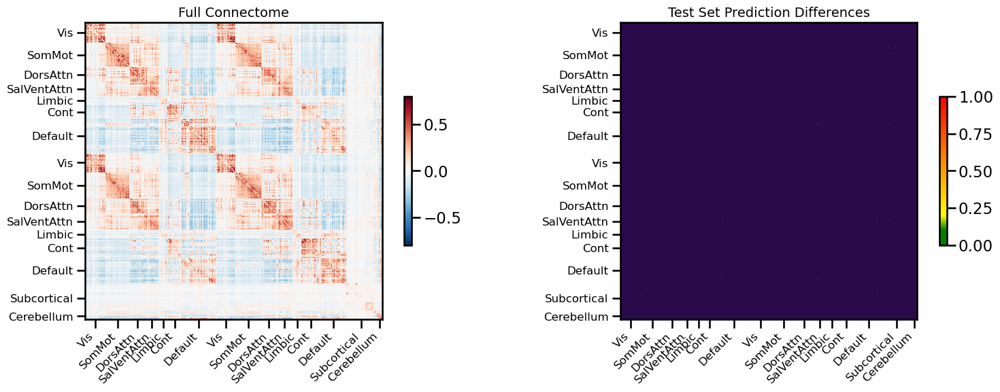

<Figure size 640x480 with 0 Axes>

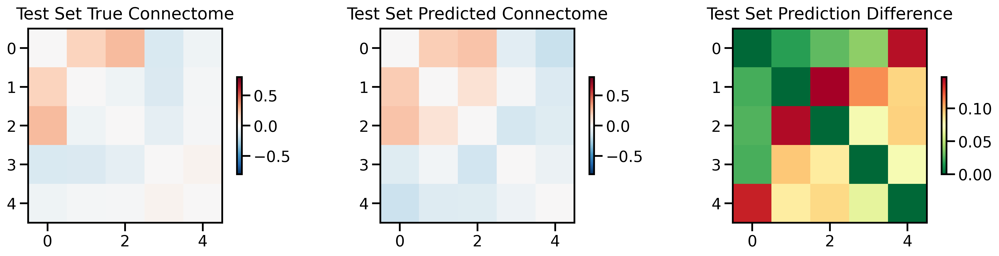

<Figure size 640x480 with 0 Axes>

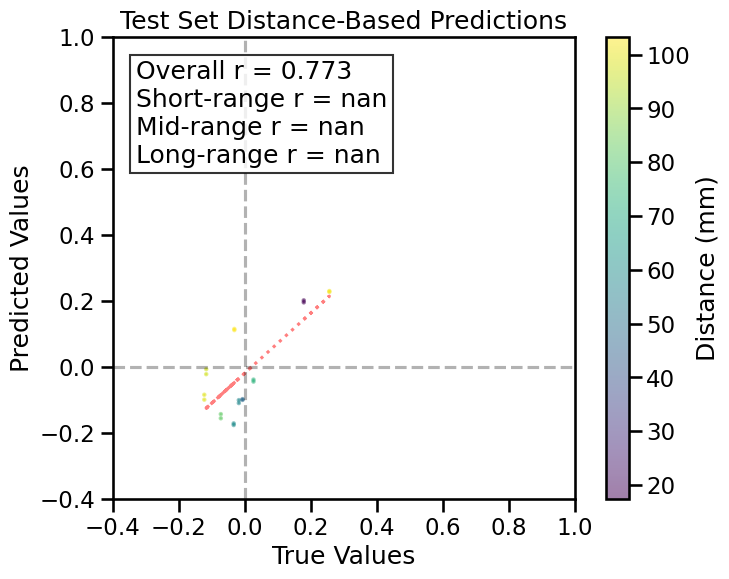

TRAIN METRICS
GLOBAL: mse=0.016731, mae=0.096328, r2=0.3209, pearson_r=0.5751, spearman_r=0.5335, geodesic_distance=33.5446
DISTANCE-BASED: short=0.6231, mid=0.5147, long=0.4283
HEMISPHERIC: left=0.5645, right=0.5734, inter=0.5883
CONNECTION STRENGTH: neg=-0.0171, weak=0.5135, pos=0.1630
NETWORK CORRELATIONS:
  NETWORK      INTRA      INTER
  ------------------------------
  Cont          0.7464    0.6661
  Default       0.5062    0.6055
  SalVentAttn    0.7627    0.6672
  Limbic        0.7316    0.6876
  DorsAttn      0.7260    0.6979
  SomMot        0.6331    0.6777
  Vis           0.6397    0.6198
  Subcortical    0.4242    0.6082
  Cerebellum    0.6128    0.5979

TEST METRICS
GLOBAL: mse=0.007980, mae=0.078871, r2=0.4064, pearson_r=0.7726, spearman_r=0.5192, geodesic_distance=2.8177
HEMISPHERIC: left=0.9947, inter=0.7332
NETWORK CORRELATIONS:
  NETWORK      INTRA      INTER
  ------------------------------
  Default          N/A    0.8005
  SalVentAttn       N/A    0.7339
  SomMot 

  from IPython.core.display import HTML, display  # type: ignore



best_val_loss,▁
test_mse_loss,▁
train_mse_loss,▁
best_val_loss,0
test_mse_loss,4.36812
train_mse_loss,4.37687


Final evaluation metrics logged successfully.
CPU Usage: 1.6%
RAM Usage: 6.1%
Available RAM: 1.4T
Total RAM: 1.5T
| ID | GPU | MEM |
------------------
|  0 |  0% |  2% |
Sim complete
Simulation completed in 112.15 seconds (1.87 minutes)


0

<Figure size 640x480 with 0 Axes>

In [14]:
single_sim_run(
              feature_type=[{'transcriptome': None}],
              train_shared_regions=False,
              test_shared_regions=False,
              omit_subcortical=False,
              dataset='HCP',
              parcellation='S456',
              hemisphere='both',
              connectome_target='FC',
              impute_strategy='mirror_interpolate',
              sort_genes='expression',
              gene_list='100_var',
              cv_type='random_full',
              random_seed=42,
              search_method=('wandb', 'mse', 2),
              track_wandb=True,
              skip_cv=True,
              model_type='bilinear_CM',
              use_gpu=True,
              null_model='none',
              use_folds=[0], 
              save_model='HCP_CM_full'
)

# Clear GPU memory
if torch.cuda.is_available():
    torch.cuda.empty_cache()

# Clear CPU memory
gc.collect()